Goals:
to find the influence of environmental variables (temperature, precipitation (which will give drought trends), 
vapor pressure deficit) with wildfires in Nevada

In [1]:
import warnings

warnings.filterwarnings("ignore")

In [2]:
import geopandas as gpd
import pandas as pd
import contextily as cx
import matplotlib.pyplot as plt
import mapclassify
import plotly.express as px
import mapclassify
import rioxarray as rx
from rasterstats import zonal_stats
from pysal.lib import weights
from pysal.viz import splot
from splot.esda import plot_moran
from pysal.explore import esda
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import seaborn
import calendar
from splot import esda as esdaplot
from pointpats import (
    distance_statistics,
    QStatistic,
    random,
    PointPattern,
    centrography
)
import numpy as np
import libpysal
from sklearn.cluster import (DBSCAN,AgglomerativeClustering)
from pysal.model import spreg
import statsmodels.formula.api as sm
from sklearn.preprocessing import robust_scale

In [3]:
#reading the dataset for wildfires in nevada for 2013 - present 
df=gpd.read_file('datasets\\California\\wildfire\\BLM_NV_Wildland_Fire_Occurrence.shp')
fire_df_p=df.query('Year>=2020').query("State == 'NV'")


In [4]:
fire_df_p.shape

(2842, 33)

In [5]:
fire_df_p.head(3) #dataset with point geometry

,Agency,State,Unit_ID,Unit_Name,Fire_Code,Inc_ID,Fire_Name,Protection,Cause,Owner,...,LongNAD83,created_us,created_da,last_edite,last_edi_1,District,GlobalID,County,DispUnitID,geometry
22758,BLM,NV,NVBMD,Battle Mountain District,M29U,2020-NVBMD-020045,MM 7A,0,Human,0,...,-116.032345,None,1899-12-30,None,1899-12-30,Battle Mountain District,ad993a0a-9240-45b5-b213-1b83b3751763,Eureka,USNVCNC,POINT (583020.702 4389258.025)
22759,BLM,NV,NVBMD,Battle Mountain District,M29X,2020-NVBMD-020046,MM 7B,0,Human,0,...,-116.033712,None,1899-12-30,None,1899-12-30,Battle Mountain District,946717be-9428-4bab-a9f8-f0307f2da1e7,Eureka,USNVCNC,POINT (582899.275 4389641.552)
22760,BLM,NV,NVBMD,Battle Mountain District,M29Y,2020-NVBMD-020047,MM 7C,0,Human,0,...,-116.034612,None,1899-12-30,None,1899-12-30,Battle Mountain District,712183a8-1d7e-4f74-8144-c541d10c33c0,Eureka,USNVCNC,POINT (582819.818 4389849.376)


In [6]:
fire_df_p.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 2842 entries, 22758 to 29874
Data columns (total 33 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   Agency      2842 non-null   object        
 1   State       2842 non-null   object        
 2   Unit_ID     2842 non-null   object        
 3   Unit_Name   2842 non-null   object        
 4   Fire_Code   2749 non-null   object        
 5   Inc_ID      2842 non-null   object        
 6   Fire_Name   2842 non-null   object        
 7   Protection  2842 non-null   int32         
 8   Cause       2842 non-null   object        
 9   Owner       2842 non-null   int32         
 10  Acres       2842 non-null   float64       
 11  WUI         0 non-null      object        
 12  Size_Class  2842 non-null   object        
 13  Size_Cla_1  2842 non-null   int32         
 14  Date        2842 non-null   datetime64[ms]
 15  Month       2842 non-null   int32         
 16  Day         2842

In [7]:
fire_df_p=fire_df_p.loc[:,['Fire_Name','Acres','District','Day','Month','Year','geometry','State','County']]

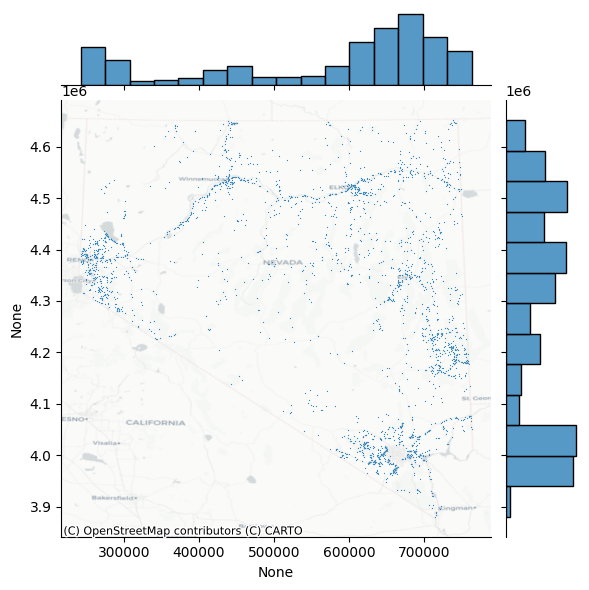

In [8]:
joint_plot=seaborn.jointplot(
    data=fire_df_p,
    x=fire_df_p.geometry.x,
    y=fire_df_p.geometry.y,
    s=0.8
)

cx.add_basemap(ax=joint_plot.ax_joint,crs=fire_df_p.crs,source=cx.providers.CartoDB.Positron)

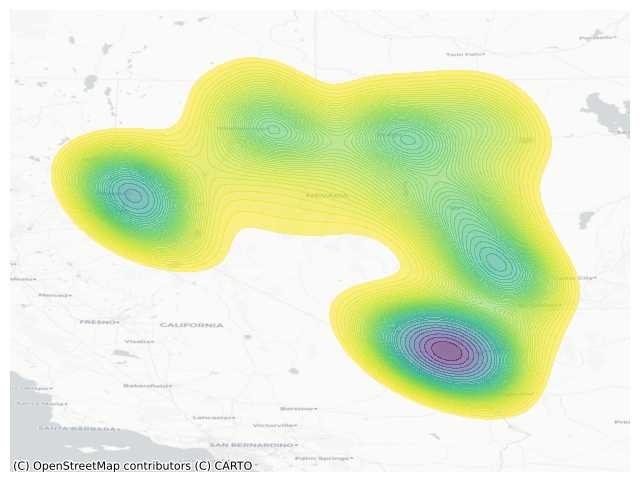

In [9]:
f,ax=plt.subplots(1,figsize=(8, 6))

seaborn.kdeplot(
    data=fire_df_p,
    x=fire_df_p.geometry.x,
    y=fire_df_p.geometry.y,
    alpha=0.55,
    cmap='viridis_r',
    shade=True,
    n_levels=50
)

cx.add_basemap(ax=ax,crs=fire_df_p.crs,source=cx.providers.CartoDB.Positron)
ax.set_axis_off()

In [10]:
path='datasets\\California\\temperature-2020\\PRISM_tmean_stable_4kmD2_20200101_bil.bil'
temp_1=rx.open_rasterio(path)
path='datasets\\California\\temperature-2020\\PRISM_tmean_stable_4kmD2_20200601_bil.bil'
temp_6=rx.open_rasterio(path)

In [11]:
path='datasets\\California\\precipitation-2020\\PRISM_ppt_stable_4kmM3_202001_bil.bil'
prec_1=rx.open_rasterio(path)
path='datasets\\California\\precipitation-2020\\PRISM_ppt_stable_4kmM3_202006_bil.bil'
prec_6=rx.open_rasterio(path)

In [12]:
temp_1.attrs

{'STATISTICS_MAXIMUM': 24.378,
 'STATISTICS_MEAN': 0.4997,
 'STATISTICS_MINIMUM': -23.816,
 'STATISTICS_NNULL': 390874,
 'STATISTICS_STDDEV': 6.5002,
 '_FillValue': np.float32(-9999.0),
 'scale_factor': 1.0,
 'add_offset': 0.0}

In [13]:
prec_1.attrs

{'STATISTICS_MAXIMUM': 2422.99609375,
 'STATISTICS_MEAN': 72.473515363266,
 'STATISTICS_MINIMUM': 0,
 'STATISTICS_STDDEV': 99.25446215854,
 '_FillValue': np.float32(-9999.0),
 'scale_factor': 1.0,
 'add_offset': 0.0}

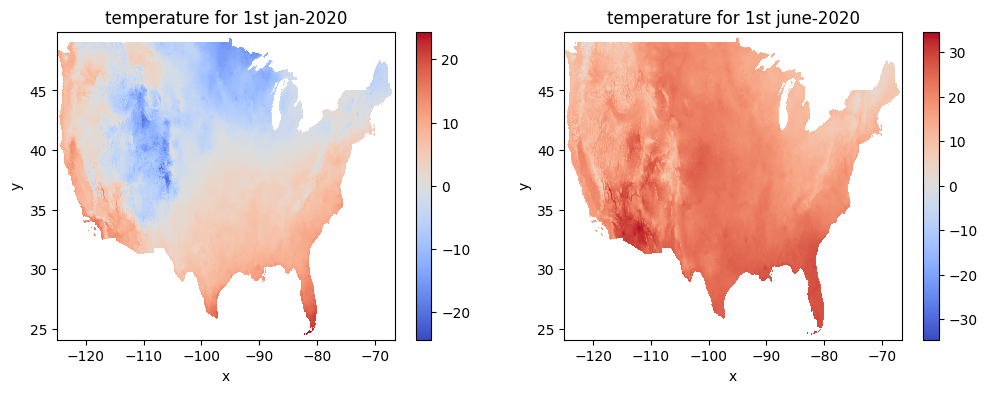

In [14]:
f,axs=plt.subplots(1,2,figsize=(12,4))
ax1,ax2=axs

temp_1.where(temp_1!=-9999).plot(cmap='coolwarm',ax=ax1)
ax1.set_title('temperature for 1st jan-2020')
temp_6.where(temp_6!=-9999).plot(cmap='coolwarm',ax=ax2)
ax2.set_title('temperature for 1st june-2020')

plt.show()

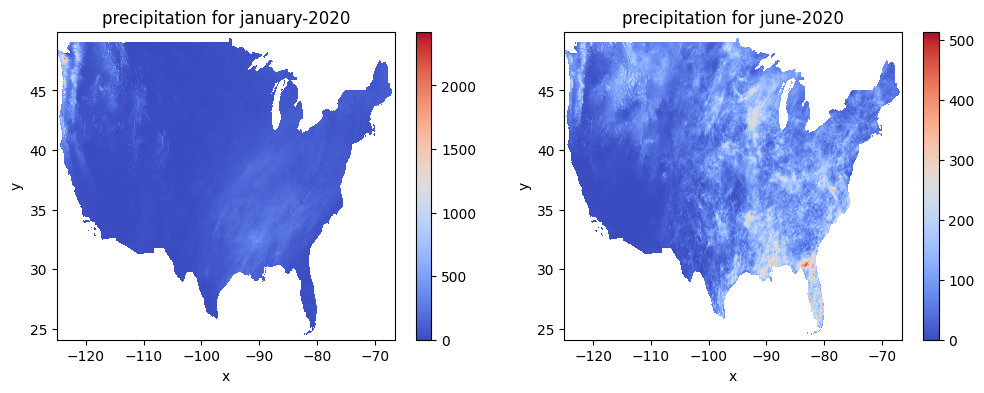

In [15]:
f,axs=plt.subplots(1,2,figsize=(12,4))
ax1,ax2=axs

prec_1.where(prec_1!=-9999.0).plot(cmap='coolwarm',ax=ax1)
ax1.set_title('precipitation for january-2020')
prec_6.where(prec_6!=-9999.0).plot(cmap='coolwarm',ax=ax2)
ax2.set_title('precipitation for june-2020')

plt.show()

In [16]:
print(temp_1.rio.resolution())
print(temp_1.rio.crs)

(0.041666666667, -0.041666666667)
OGC:CRS83


In [17]:
print(prec_1.rio.resolution())
print(prec_6.rio.crs)

(0.0416666666667, -0.0416666666667)
OGC:CRS83


In [18]:
#year 2020

#using zonal stats to find mean, max , min temperature for each wildfire location , meaning mapping the .tif file over wildfire map 
# and extarcting the temperature statistics for each wildfire
stats20=[]
wildfire_df_20=fire_df_p.query("Year==2020").copy()
for i in range(1, 13):
    
    # Get days in the current month (handles leap year)
    days_in_month = calendar.monthrange(2020, i)[1]

    m = wildfire_df_20[wildfire_df_20['Month'] == i].copy()
    m = m.to_crs(temp_1.rio.crs)

    for j in range(1, days_in_month + 1):
        m_day = m[m['Day'] == j].copy()
        if m_day.empty:
            continue

        raster_path = f'datasets\\California\\temperature-2020\\PRISM_tmean_stable_4kmD2_2020{i:02d}{j:02d}_bil.bil'
        
        try:
            zstats = zonal_stats(
                m_day['geometry'],
                raster=raster_path,
                stats='mean',
                nodata=-9999.0
            )
            
            # Combine results into dicts with fire metadata
            for idx, stat in enumerate(zstats):
                row = m_day.iloc[idx].copy()
                row[f'mean_temp'] = int(stat['mean'])
                stats20.append(row)
        
        except FileNotFoundError:
            print(f"Missing raster for 2020-{i:02d}-{j:02d}, skipping.")

In [19]:
#year 2021

stats21=[]
wildfire_df_21=fire_df_p.query("Year==2021").copy()
for i in range(1, 13):
    
    # Get days in the current month (handles leap year)
    days_in_month = calendar.monthrange(2021, i)[1]

    m = wildfire_df_21[wildfire_df_21['Month'] == i].copy()
    m = m.to_crs(temp_1.rio.crs)

    for j in range(1, days_in_month + 1):
        m_day = m[m['Day'] == j].copy()
        if m_day.empty:
            continue

        raster_path = f'datasets\\California\\temperature-2021\\PRISM_tmean_stable_4kmD2_2021{i:02d}{j:02d}_bil.bil'
        
        try:
            zstats = zonal_stats(
                m_day['geometry'],
                raster=raster_path,
                stats=['mean'],
                nodata=-9999.0
            )

            # Combine results into dicts with fire metadata
            for idx, stat in enumerate(zstats):
                row = m_day.iloc[idx].copy()
                row[f'mean_temp'] = int(stat['mean'])
                stats21.append(row)
                
        except FileNotFoundError:
            print(f"Missing raster for 2021-{i:02d}-{j:02d}, skipping.")

In [20]:
#year 2022

stats22=[]
wildfire_df_22=fire_df_p.query("Year==2022").copy()
for i in range(1, 13):
    
    # Get days in the current month (handles leap year)
    days_in_month = calendar.monthrange(2022, i)[1]

    m = wildfire_df_22[wildfire_df_22['Month'] == i].copy()
    m = m.to_crs(temp_1.rio.crs)

    for j in range(1, days_in_month + 1):
        m_day = m[m['Day'] == j].copy()
        if m_day.empty:
            continue

        raster_path = f'datasets\\California\\temperature-2022\\PRISM_tmean_stable_4kmD2_2022{i:02d}{j:02d}_bil.bil'
        
        try:
            zstats = zonal_stats(
                m_day['geometry'],
                raster=raster_path,
                stats=['mean'],
                nodata=-9999.0
            )

            # Combine results into dicts with fire metadata
            for idx, stat in enumerate(zstats):
                row = m_day.iloc[idx].copy()
                row[f'mean_temp'] = int(stat['mean'])
                stats22.append(row)
        
        except FileNotFoundError:
            print(f"Missing raster for 2022-{i:02d}-{j:02d}, skipping.")

In [21]:
#converting stats values to dataframe
wildfire_df_20=gpd.GeoDataFrame(stats20,crs=temp_1.rio.crs)
wildfire_df_21=gpd.GeoDataFrame(stats21,crs=temp_1.rio.crs)
wildfire_df_22=gpd.GeoDataFrame(stats22,crs=temp_1.rio.crs)

In [22]:
#year 2020

#using zonal stats to find mean precipitation for each wildfire location , meaning mapping the .tif file over wildfire map 
# and extarcting the precipitation statistics for each wildfire
stats20=[]
for i in range(1,13):
    m=wildfire_df_20[wildfire_df_20['Month']==i].copy()
    m=m.to_crs(prec_1.rio.crs) #crs needs to be same otherwise NaN values encountered

    raster_path = f'datasets\\California\\precipitation-2020\\PRISM_ppt_stable_4kmM3_2020{i:02d}_bil.bil'
     
    stats20.append(zonal_stats(m['geometry'],
                  raster=raster_path,
                  stats=['mean'],
                  nodata=-9999.0))

In [23]:
#year 2021

stats21=[]
for i in range(1,13):
    m=wildfire_df_21[wildfire_df_21['Month']==i].copy()
    m=m.to_crs(temp_1.rio.crs) #crs needs to be same otherwise NaN values encountered

    raster_path = f'datasets\\California\\precipitation-2021\\PRISM_ppt_stable_4kmM3_2021{i:02d}_bil.bil'
     
    stats21.append(zonal_stats(m['geometry'],
                  raster=raster_path,
                  stats=['mean'],
                  nodata=-9999.0))

In [24]:
#year 2022

stats22=[]
for i in range(1,13):
    m=wildfire_df_22[wildfire_df_22['Month']==i].copy()
    m=m.to_crs(temp_1.rio.crs) #crs needs to be same otherwise NaN values encountered

    raster_path = f'datasets\\California\\precipitation-2022\\PRISM_ppt_stable_4kmM3_2022{i:02d}_bil.bil'
     
    stats22.append(zonal_stats(m['geometry'],
                  raster=raster_path,
                  stats=['mean'],
                  nodata=-9999.0))

In [25]:
#extracting mean precipitation value according to each fire location for the given month and joining them to make new dataset
wildfire_df_20['mean_prec']=None
for i in range(1,13):
    m=[s['mean'] for s in stats20[i-1]]
    mask=wildfire_df_20['Month']==i
    wildfire_df_20.loc[mask,'mean_prec']=m

wildfire_df_21['mean_prec']=None
for i in range(1,13):
    m=[s['mean'] for s in stats21[i-1]]
    mask=wildfire_df_21['Month']==i
    wildfire_df_21.loc[mask,'mean_prec']=m

wildfire_df_22['mean_prec']=None
for i in range(1,13):
    m=[s['mean'] for s in stats22[i-1]]
    mask=wildfire_df_22['Month']==i
    wildfire_df_22.loc[mask,'mean_prec']=m

In [26]:
#year 2020

#using zonal stats to find mean vapour pressure deficit for each wildfire location , meaning mapping the .tif file over wildfire map 
# and extarcting the vpd statistics for each wildfire
stats20=[]
for i in range(1,13):
    m=wildfire_df_20[wildfire_df_20['Month']==i].copy()
    m=m.to_crs(prec_1.rio.crs) #crs needs to be same otherwise NaN values encountered

    raster_path = f'datasets\\California\\VPD-2020\\PRISM_vpdmax_stable_4kmM3_2020{i:02d}_bil.bil'
     
    stats20.append(zonal_stats(m['geometry'],
                  raster=raster_path,
                  stats=['mean'],
                  nodata=-9999.0))

In [27]:
#year 2021
stats21=[]
for i in range(1,13):
    m=wildfire_df_21[wildfire_df_21['Month']==i].copy()
    m=m.to_crs(prec_1.rio.crs) #crs needs to be same otherwise NaN values encountered

    raster_path = f'datasets\\California\\VPD-2021\\PRISM_vpdmax_stable_4kmM3_2021{i:02d}_bil.bil'
     
    stats21.append(zonal_stats(m['geometry'],
                  raster=raster_path,
                  stats=['mean'],
                  nodata=-9999.0))

In [28]:
#year 2022
stats22=[]
for i in range(1,13):
    m=wildfire_df_22[wildfire_df_22['Month']==i].copy()
    m=m.to_crs(prec_1.rio.crs) #crs needs to be same otherwise NaN values encountered

    raster_path = f'datasets\\California\\VPD-2022\\PRISM_vpdmax_stable_4kmM3_2022{i:02d}_bil.bil'
     
    stats22.append(zonal_stats(m['geometry'],
                  raster=raster_path,
                  stats=['mean'],
                  nodata=-9999.0))

In [29]:
#extracting mean vpd value according to each fire location for the given month and joining them to make new dataset
wildfire_df_20['mean_vpd']=None
for i in range(1,13):
    m=[s['mean'] for s in stats20[i-1]]
    mask=wildfire_df_20['Month']==i
    wildfire_df_20.loc[mask,'mean_vpd']=m

wildfire_df_21['mean_vpd']=None
for i in range(1,13):
    m=[s['mean'] for s in stats21[i-1]]
    mask=wildfire_df_21['Month']==i
    wildfire_df_21.loc[mask,'mean_vpd']=m

wildfire_df_22['mean_vpd']=None
for i in range(1,13):
    m=[s['mean'] for s in stats22[i-1]]
    mask=wildfire_df_22['Month']==i
    wildfire_df_22.loc[mask,'mean_vpd']=m

In [30]:
wildfire_df_20.head(3)

,Fire_Name,Acres,District,Day,Month,Year,geometry,State,County,mean_temp,mean_prec,mean_vpd
22938,Ophir,0.2,Carson City District,12,1,2020,POINT (-119.84711 39.29871),NV,Washoe,0,6.86,7.003
22818,CCFD1- WETLANDS -SND PROTECTION,0.1,Southern Nevada District,21,1,2020,POINT (-115.00271 36.08757),NV,Clark,13,0.0,14.002
22939,Poeville,69.0,Carson City District,1,2,2020,POINT (-119.90181 39.58441),NV,Washoe,7,0.07,9.098


In [31]:
#calculating weights 
w_20=weights.distance.KNN.from_dataframe(
    wildfire_df_20,k=8
)

w_21=weights.distance.KNN.from_dataframe(
    wildfire_df_21,k=8
)   

w_22=weights.distance.KNN.from_dataframe(
    wildfire_df_22,k=8
)


In [32]:
#row transforming them to convert them to non-binary weights
w_20.transform='R'
w_21.transform='R'
w_22.transform='R'
print(f"pct-non zero 2020: {w_20.pct_nonzero}")
print(f"pct-non zero 2021: {w_21.pct_nonzero}")
print(f"pct-non zero 2022: {w_22.pct_nonzero}")

pct-non zero 2020: 1.08843537414966
pct-non zero 2021: 1.3961605584642234
pct-non zero 2022: 1.694915254237288


In [33]:
#calculating spatial lag for mean temperature
wildfire_df_20['mean_temp_lag']=weights.spatial_lag.lag_spatial(w_20,wildfire_df_20['mean_temp'])
wildfire_df_21['mean_temp_lag']=weights.spatial_lag.lag_spatial(w_21,wildfire_df_21['mean_temp'])
wildfire_df_22['mean_temp_lag']=weights.spatial_lag.lag_spatial(w_22,wildfire_df_22['mean_temp'])


In [34]:
wildfire_df_20.head(5)

,Fire_Name,Acres,District,Day,Month,Year,geometry,State,County,mean_temp,mean_prec,mean_vpd,mean_temp_lag
22938,Ophir,0.2,Carson City District,12,1,2020,POINT (-119.84711 39.29871),NV,Washoe,0,6.86,7.003,19.625
22818,CCFD1- WETLANDS -SND PROTECTION,0.1,Southern Nevada District,21,1,2020,POINT (-115.00271 36.08757),NV,Clark,13,0.0,14.002,27.750
22939,Poeville,69.0,Carson City District,1,2,2020,POINT (-119.90181 39.58441),NV,Washoe,7,0.07,9.098,20.375
23029,Mullen Canyon,0.3,Winnemucca District,2,2,2020,POINT (-117.72723 40.85652),NV,Humboldt,7,7.388,8.09,16.125
23042,SHOOTING PIT,0.1,Southern Nevada District,14,2,2020,POINT (-115.21641 35.88191),NV,Clark,7,7.162,14.519,28.625


In [35]:
def plot_2_graphs(dataframe,column_1,column_2,title_1,title_2,scheme,cmap,cxsource,k=5):
    f, axs = plt.subplots(1, 2, figsize=(12, 6))
    ax1, ax2 = axs

    dataframe.plot(
        column=column_1,
        cmap=cmap,
        scheme=scheme,
        k=k,
        edgecolor="white",
        linewidth=0.0,
        alpha=0.75,
        legend=True,
        ax=ax1,
    )
    ax1.set_axis_off()
    ax1.set_title(title_1)
    cx.add_basemap(ax=ax1,crs=wildfire_df_22.crs,source=cxsource)

    dataframe.plot(
        column=column_2,
        cmap=cmap,
        scheme=scheme,
        k=k,
        edgecolor="white",
        linewidth=0.0,
        alpha=0.75,
        legend=True,
        ax=ax2,
    )
    ax2.set_axis_off()
    ax2.set_title(title_2)
    cx.add_basemap(ax=ax2,crs=wildfire_df_22.crs,source=cxsource)

    plt.show()

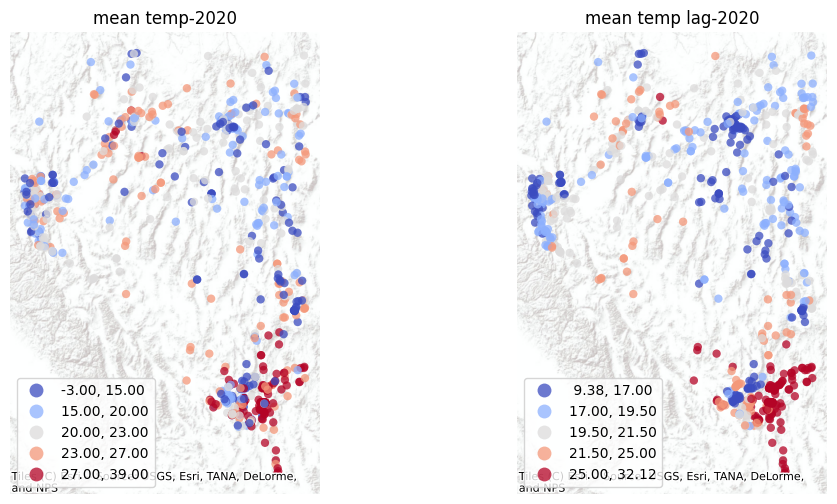

In [36]:
plot_2_graphs(wildfire_df_20,"mean_temp","mean_temp_lag","mean temp-2020","mean temp lag-2020","quantiles","coolwarm",
              cx.providers.Esri.WorldTerrain)

In [192]:
scaling=wildfire_df_20[['mean_temp']]
scaling_2=wildfire_df_20[['mean_temp_lag']]

In [189]:
scaling.head(3)

,mean_temp
22938,0
22818,13
22939,7


In [194]:
scaling_2.head(3)

,mean_temp_lag
22938,19.625
22818,27.750
22939,20.375


In [195]:
scaled_data=robust_scale(scaling)
scaled_data_2=robust_scale(scaling_2)

In [191]:
wildfire_df_20['scaled_data']=scaled_data

In [196]:
wildfire_df_20['scaled_lag_temp']=scaled_data_2

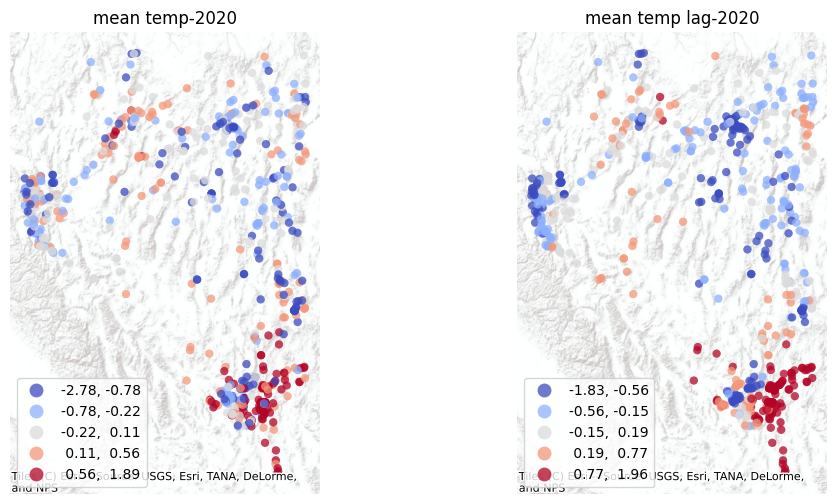

In [197]:
plot_2_graphs(wildfire_df_20,"scaled_data","scaled_lag_temp","mean temp-2020","mean temp lag-2020","quantiles","coolwarm",
              cx.providers.Esri.WorldTerrain)

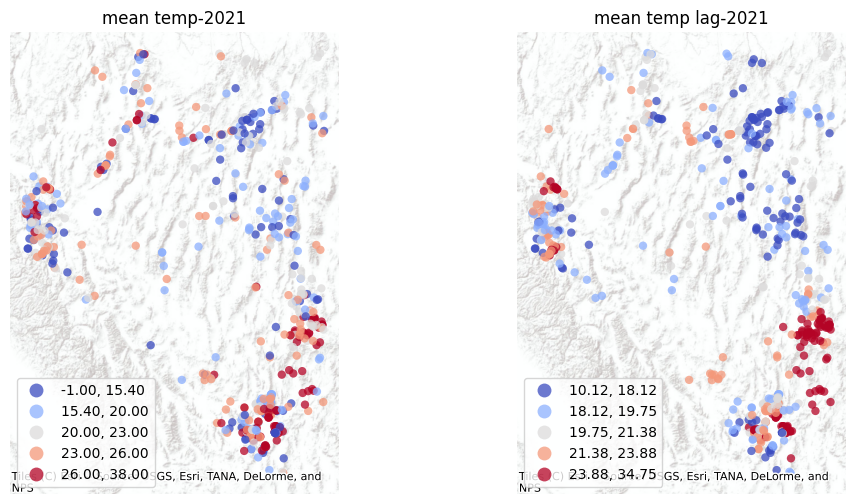

In [37]:
plot_2_graphs(wildfire_df_21,"mean_temp","mean_temp_lag","mean temp-2021","mean temp lag-2021","quantiles","coolwarm",
              cx.providers.Esri.WorldTerrain)

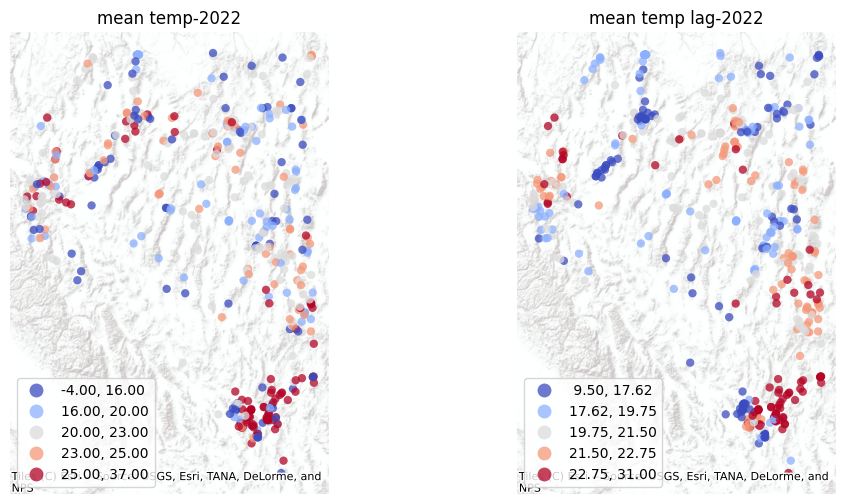

In [38]:
plot_2_graphs(wildfire_df_22,"mean_temp","mean_temp_lag","mean temp-2022","mean temp lag-2022","quantiles","coolwarm",
              cx.providers.Esri.WorldTerrain)

In [39]:
#calculating spatial lag for mean precipitation
wildfire_df_20['mean_prec']=pd.to_numeric(wildfire_df_20['mean_prec'])
wildfire_df_20['mean_prec_lag']=weights.spatial_lag.lag_spatial(w_20,wildfire_df_20['mean_prec'])


wildfire_df_21['mean_prec']=pd.to_numeric(wildfire_df_21['mean_prec'])
wildfire_df_21['mean_prec_lag']=weights.spatial_lag.lag_spatial(w_21,wildfire_df_21['mean_prec'])


wildfire_df_22['mean_prec']=pd.to_numeric(wildfire_df_22['mean_prec'])
wildfire_df_22['mean_prec_lag']=weights.spatial_lag.lag_spatial(w_22,wildfire_df_22['mean_prec'])


In [40]:
wildfire_df_20.head(3)

,Fire_Name,Acres,District,Day,Month,Year,geometry,State,County,mean_temp,mean_prec,mean_vpd,mean_temp_lag,mean_prec_lag
22938,Ophir,0.2,Carson City District,12,1,2020,POINT (-119.84711 39.29871),NV,Washoe,0,6.86,7.003,19.625,4.746500
22818,CCFD1- WETLANDS -SND PROTECTION,0.1,Southern Nevada District,21,1,2020,POINT (-115.00271 36.08757),NV,Clark,13,0.00,14.002,27.750,6.111000
22939,Poeville,69.0,Carson City District,1,2,2020,POINT (-119.90181 39.58441),NV,Washoe,7,0.07,9.098,20.375,4.127125


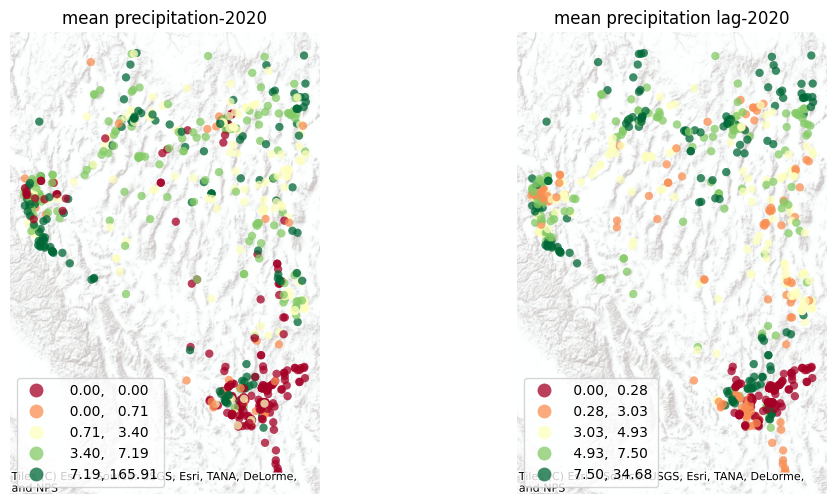

In [41]:
plot_2_graphs(wildfire_df_20,"mean_prec","mean_prec_lag","mean precipitation-2020","mean precipitation lag-2020","quantiles","RdYlGn",
              cx.providers.Esri.WorldTerrain)

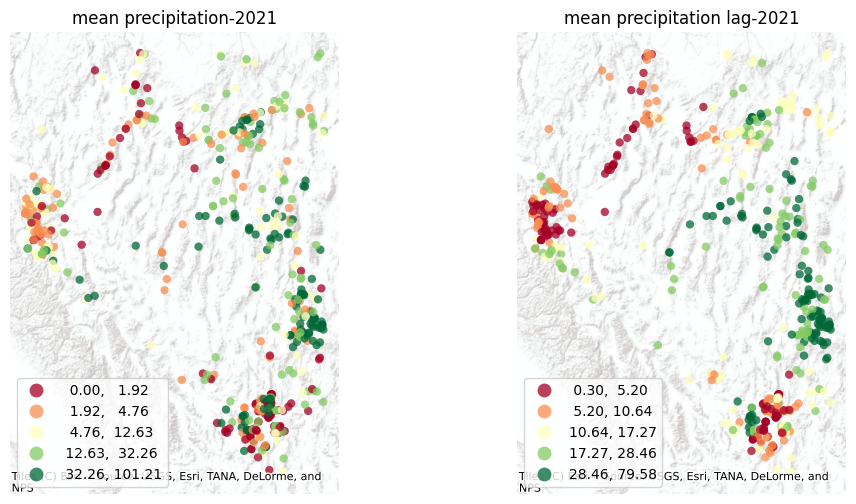

In [42]:
plot_2_graphs(wildfire_df_21,"mean_prec","mean_prec_lag","mean precipitation-2021","mean precipitation lag-2021","quantiles","RdYlGn",
              cx.providers.Esri.WorldTerrain)

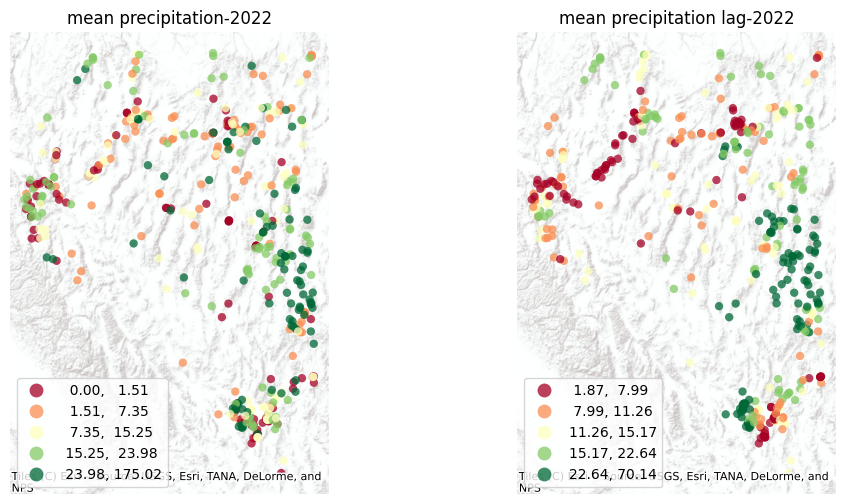

In [43]:
plot_2_graphs(wildfire_df_22,"mean_prec","mean_prec_lag","mean precipitation-2022","mean precipitation lag-2022","quantiles","RdYlGn",
              cx.providers.Esri.WorldTerrain)

In [44]:
#calculating spatial lag for mean vpd
wildfire_df_20['mean_vpd']=pd.to_numeric(wildfire_df_20['mean_vpd'])
wildfire_df_20['mean_vpd_lag']=weights.spatial_lag.lag_spatial(w_20,wildfire_df_20['mean_vpd'])


wildfire_df_21['mean_vpd']=pd.to_numeric(wildfire_df_21['mean_vpd'])
wildfire_df_21['mean_vpd_lag']=weights.spatial_lag.lag_spatial(w_21,wildfire_df_21['mean_vpd'])


wildfire_df_22['mean_vpd']=pd.to_numeric(wildfire_df_22['mean_vpd'])
wildfire_df_22['mean_vpd_lag']=weights.spatial_lag.lag_spatial(w_22,wildfire_df_22['mean_vpd'])


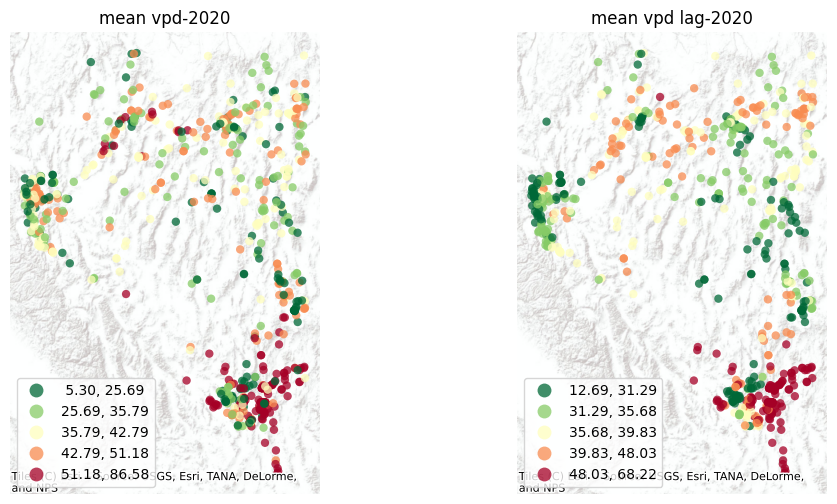

In [45]:
plot_2_graphs(wildfire_df_20,'mean_vpd','mean_vpd_lag',"mean vpd-2020","mean vpd lag-2020","quantiles","RdYlGn_r",
              cx.providers.Esri.WorldTerrain)

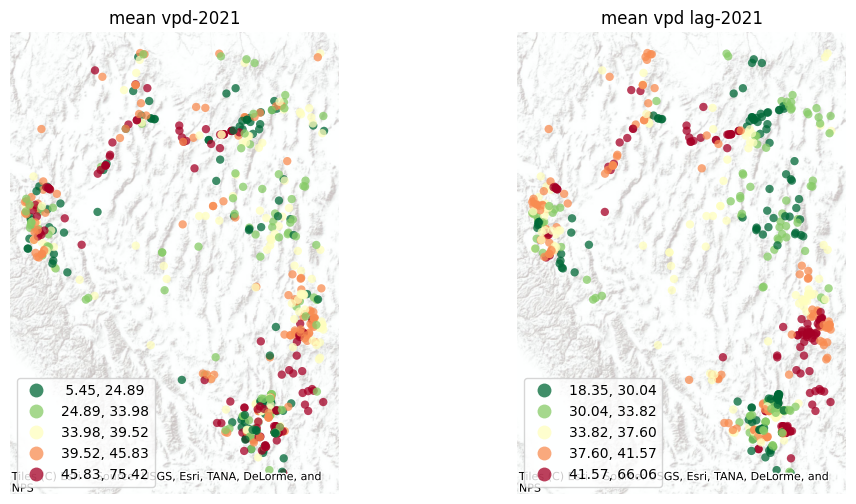

In [46]:
plot_2_graphs(wildfire_df_21,'mean_vpd','mean_vpd_lag',"mean vpd-2021","mean vpd lag-2021","quantiles","RdYlGn_r",
              cx.providers.Esri.WorldTerrain)

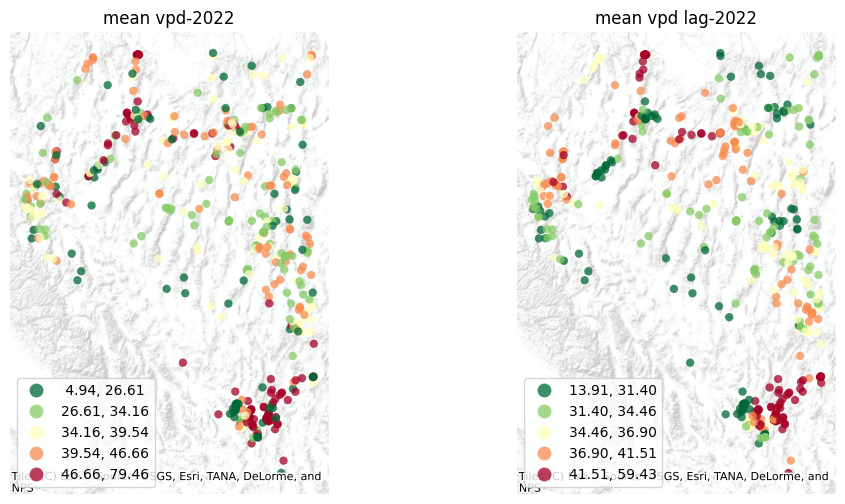

In [47]:
plot_2_graphs(wildfire_df_22,'mean_vpd','mean_vpd_lag',"mean vpd-2022","mean vpd lag-2022","quantiles","RdYlGn_r",
              cx.providers.Esri.WorldTerrain)

In [48]:
#merging datasets for each year
wild_fire_all=gpd.GeoDataFrame(pd.concat([wildfire_df_20,wildfire_df_21,wildfire_df_22],ignore_index=True))

In [49]:
wild_fire_all.head(3)

,Fire_Name,Acres,District,Day,Month,Year,geometry,State,County,mean_temp,mean_prec,mean_vpd,mean_temp_lag,mean_prec_lag,mean_vpd_lag
0,Ophir,0.2,Carson City District,12,1,2020,POINT (-119.84711 39.29871),NV,Washoe,0,6.86,7.003,19.625,4.746500,29.747125
1,CCFD1- WETLANDS -SND PROTECTION,0.1,Southern Nevada District,21,1,2020,POINT (-115.00271 36.08757),NV,Clark,13,0.00,14.002,27.750,6.111000,56.090876
2,Poeville,69.0,Carson City District,1,2,2020,POINT (-119.90181 39.58441),NV,Washoe,7,0.07,9.098,20.375,4.127125,33.768500


In [50]:
#mapping month to each season
wild_fire_all['season']=wild_fire_all['Month'].map({3:'spring',4:'spring',5:'spring',6:'summer',7:'summer',8:'summer'
                                                   ,9:'fall',10:'fall',11:'fall',12:'winter',1:'winter',2:'winter'})

In [51]:
wild_fire_all.head(5)

,Fire_Name,Acres,District,Day,Month,Year,geometry,State,County,mean_temp,mean_prec,mean_vpd,mean_temp_lag,mean_prec_lag,mean_vpd_lag,season
0,Ophir,0.2,Carson City District,12,1,2020,POINT (-119.84711 39.29871),NV,Washoe,0,6.860,7.003,19.625,4.746500,29.747125,winter
1,CCFD1- WETLANDS -SND PROTECTION,0.1,Southern Nevada District,21,1,2020,POINT (-115.00271 36.08757),NV,Clark,13,0.000,14.002,27.750,6.111000,56.090876,winter
2,Poeville,69.0,Carson City District,1,2,2020,POINT (-119.90181 39.58441),NV,Washoe,7,0.070,9.098,20.375,4.127125,33.768500,winter
3,Mullen Canyon,0.3,Winnemucca District,2,2,2020,POINT (-117.72723 40.85652),NV,Humboldt,7,7.388,8.090,16.125,9.730500,25.767250,winter
4,SHOOTING PIT,0.1,Southern Nevada District,14,2,2020,POINT (-115.21641 35.88191),NV,Clark,7,7.162,14.519,28.625,0.013125,50.607625,winter


In [52]:
spring=wild_fire_all.query('season=="spring"')
summer=wild_fire_all.query('season=="summer"')
fall=wild_fire_all.query('season=="fall"')
winter=wild_fire_all.query('season=="winter"')

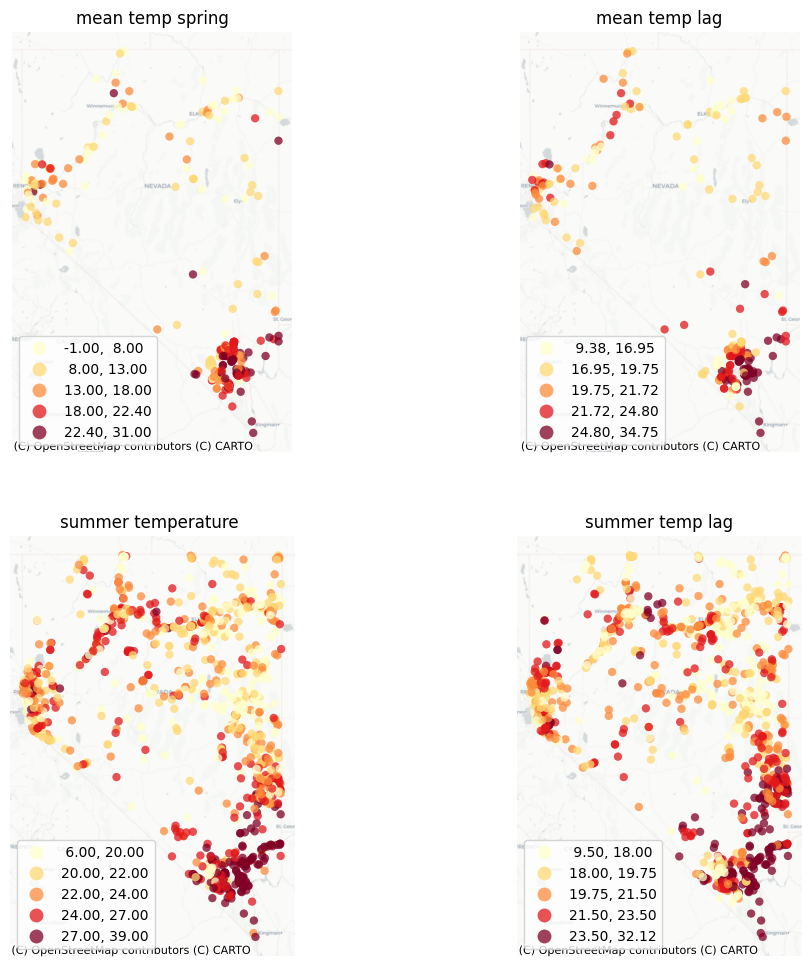

In [53]:
f, axs = plt.subplots(2, 2, figsize=(12, 12))

spring.plot(
    column="mean_temp",
    cmap="YlOrRd",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][0],
)
axs[0][0].set_axis_off()
axs[0][0].set_title("mean temp spring")
cx.add_basemap(
    axs[0][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)
spring.plot(
    column="mean_temp_lag",
    cmap='YlOrRd',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][1],
)
axs[0][1].set_axis_off()
axs[0][1].set_title("mean temp lag")
cx.add_basemap(
    axs[0][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

summer.plot(
    column="mean_temp",
    cmap='YlOrRd',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][0],
)
axs[1][0].set_axis_off()
axs[1][0].set_title("summer temperature ")
cx.add_basemap(
    axs[1][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

summer.plot(
    column="mean_temp_lag",
    cmap='YlOrRd',
    scheme='quantiles',
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][1],
)
axs[1][1].set_axis_off()
axs[1][1].set_title("summer temp lag")
cx.add_basemap(
    axs[1][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

plt.show()

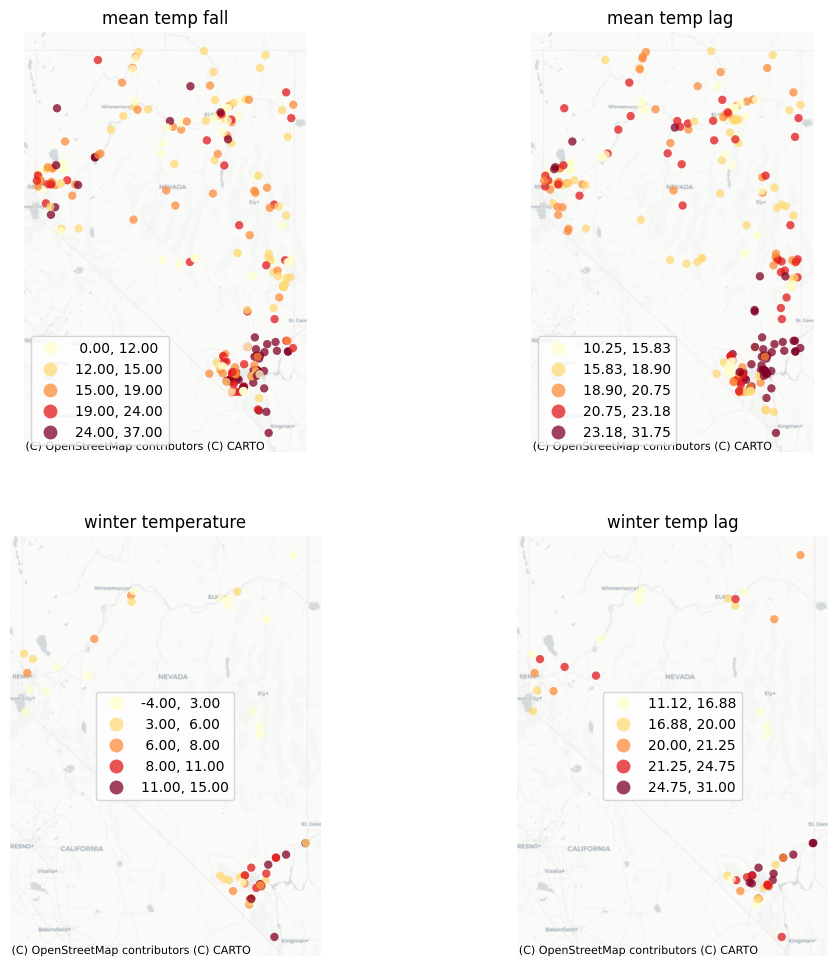

In [54]:

f, axs = plt.subplots(2, 2, figsize=(12, 12))

fall.plot(
    column="mean_temp",
    cmap="YlOrRd",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][0],
)
axs[0][0].set_axis_off()
axs[0][0].set_title("mean temp fall")
cx.add_basemap(
    axs[0][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)
fall.plot(
    column="mean_temp_lag",
    cmap='YlOrRd',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][1],
)
axs[0][1].set_axis_off()
axs[0][1].set_title("mean temp lag ")
cx.add_basemap(
    axs[0][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

winter.plot(
    column="mean_temp",
    cmap='YlOrRd',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][0],
)
axs[1][0].set_axis_off()
axs[1][0].set_title("winter temperature")
cx.add_basemap(
    axs[1][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

winter.plot(
    column="mean_temp_lag",
    cmap='YlOrRd',
    scheme='quantiles',
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][1],
)
axs[1][1].set_axis_off()
axs[1][1].set_title("winter temp lag")
cx.add_basemap(
    axs[1][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

plt.show()

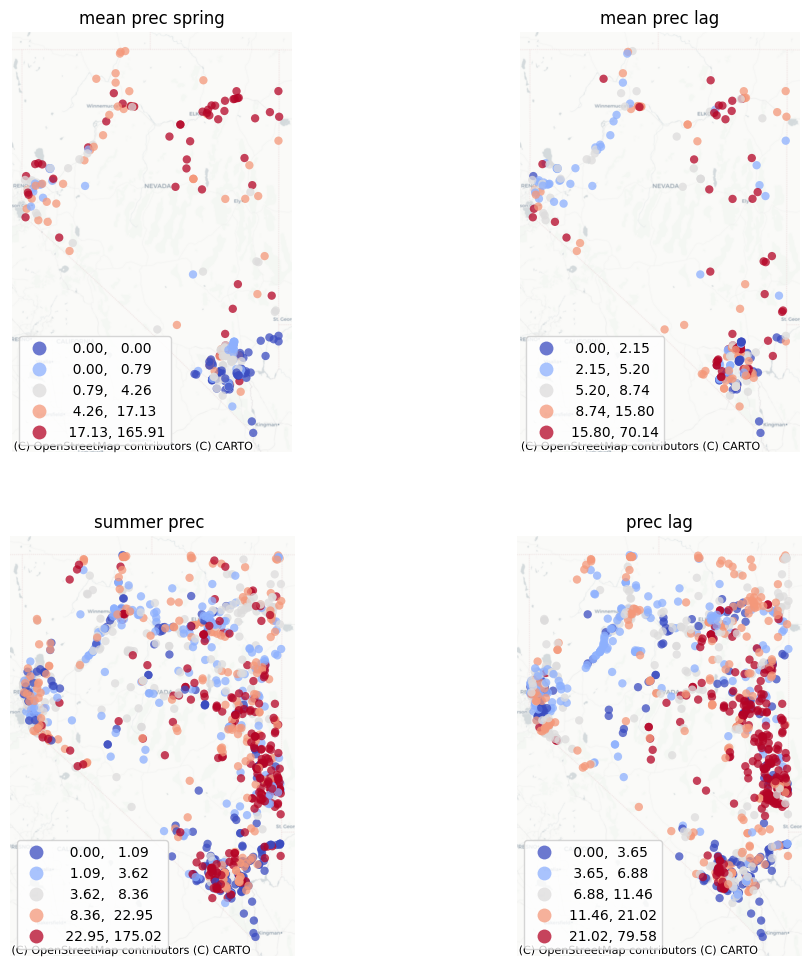

In [55]:
f, axs = plt.subplots(2, 2, figsize=(12, 12))

spring.plot(
    column="mean_prec",
    cmap="coolwarm",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][0],
)
axs[0][0].set_axis_off()
axs[0][0].set_title("mean prec spring")
cx.add_basemap(
    axs[0][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)
spring.plot(
    column="mean_prec_lag",
    cmap='coolwarm',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][1],
)
axs[0][1].set_axis_off()
axs[0][1].set_title("mean prec lag")
cx.add_basemap(
    axs[0][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

summer.plot(
    column="mean_prec",
    cmap='coolwarm',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][0],
)
axs[1][0].set_axis_off()
axs[1][0].set_title("summer prec ")
cx.add_basemap(
    axs[1][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

summer.plot(
    column="mean_prec_lag",
    cmap='coolwarm',
    scheme='quantiles',
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][1],
)
axs[1][1].set_axis_off()
axs[1][1].set_title("prec lag")
cx.add_basemap(
    axs[1][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

plt.show()

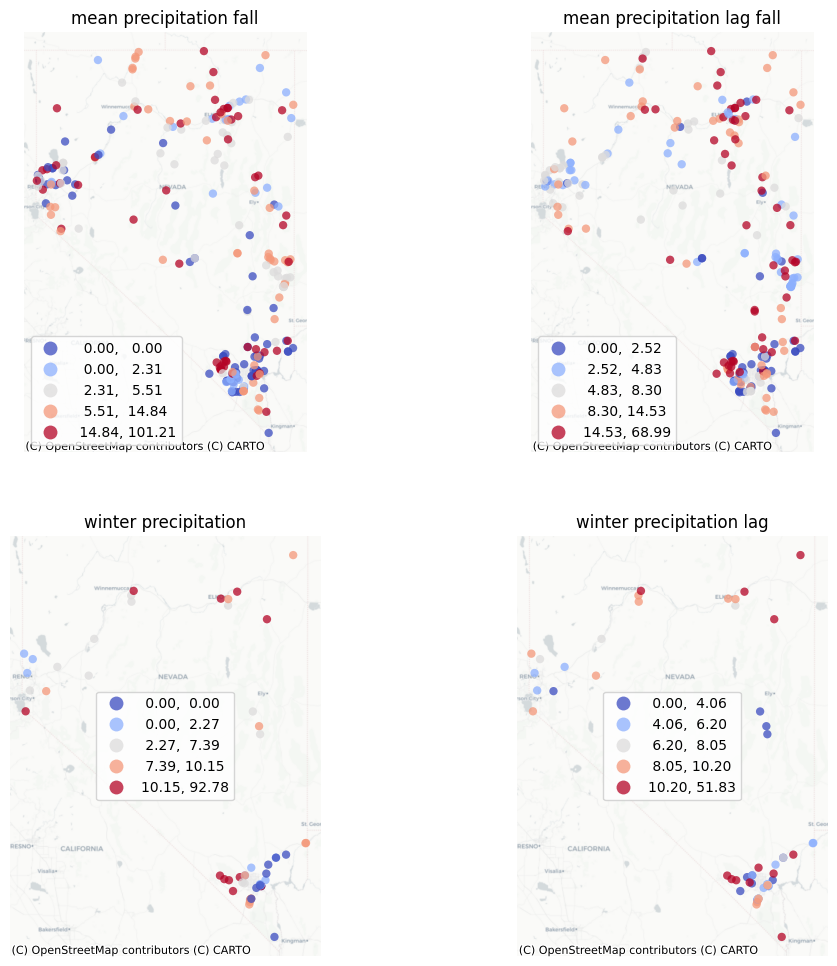

In [56]:
f, axs = plt.subplots(2, 2, figsize=(12, 12))

fall.plot(
    column="mean_prec",
    cmap="coolwarm",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][0],
)
axs[0][0].set_axis_off()
axs[0][0].set_title("mean precipitation fall")
cx.add_basemap(
    axs[0][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)
fall.plot(
    column="mean_prec_lag",
    cmap='coolwarm',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][1],
)
axs[0][1].set_axis_off()
axs[0][1].set_title("mean precipitation lag fall")
cx.add_basemap(
    axs[0][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

winter.plot(
    column="mean_prec",
    cmap='coolwarm',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][0],
)
axs[1][0].set_axis_off()
axs[1][0].set_title("winter precipitation")
cx.add_basemap(
    axs[1][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

winter.plot(
    column="mean_prec_lag",
    cmap='coolwarm',
    scheme='quantiles',
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][1],
)
axs[1][1].set_axis_off()
axs[1][1].set_title("winter precipitation lag")
cx.add_basemap(
    axs[1][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

plt.show()

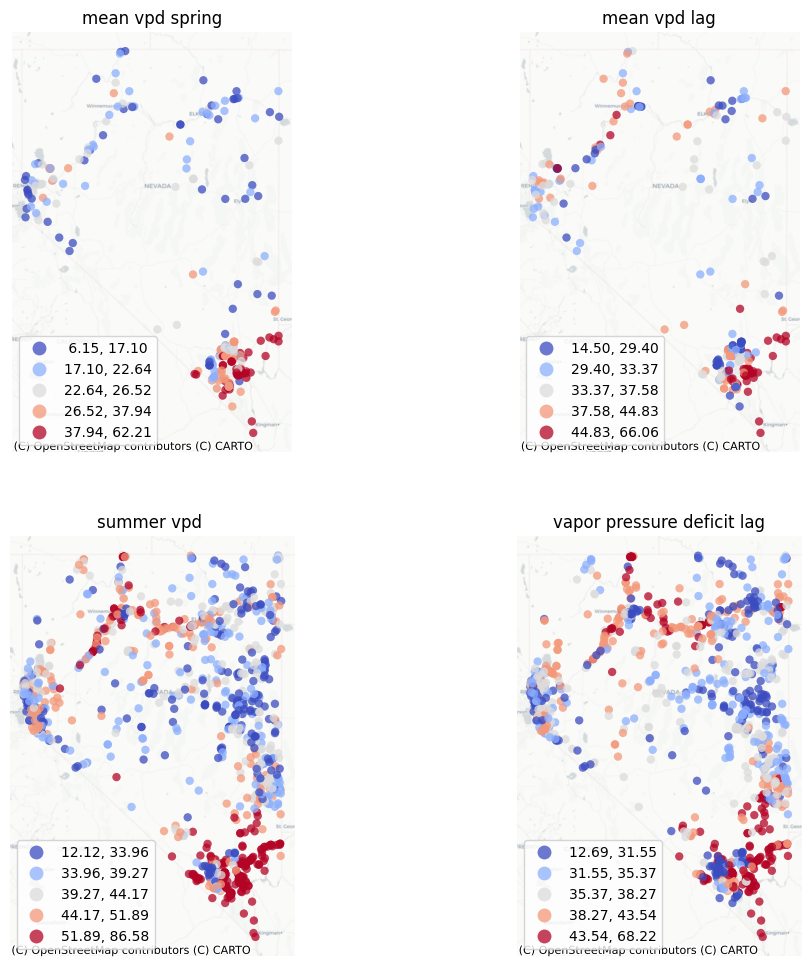

In [57]:
f, axs = plt.subplots(2, 2, figsize=(12, 12))

spring.plot(
    column="mean_vpd",
    cmap="coolwarm",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][0],
)
axs[0][0].set_axis_off()
axs[0][0].set_title("mean vpd spring")
cx.add_basemap(
    axs[0][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)
spring.plot(
    column="mean_vpd_lag",
    cmap='coolwarm',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][1],
)
axs[0][1].set_axis_off()
axs[0][1].set_title("mean vpd lag")
cx.add_basemap(
    axs[0][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

summer.plot(
    column="mean_vpd",
    cmap='coolwarm',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][0],
)
axs[1][0].set_axis_off()
axs[1][0].set_title("summer vpd ")
cx.add_basemap(
    axs[1][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

summer.plot(
    column="mean_vpd_lag",
    cmap='coolwarm',
    scheme='quantiles',
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][1],
)
axs[1][1].set_axis_off()
axs[1][1].set_title("vapor pressure deficit lag")
cx.add_basemap(
    axs[1][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

plt.show()

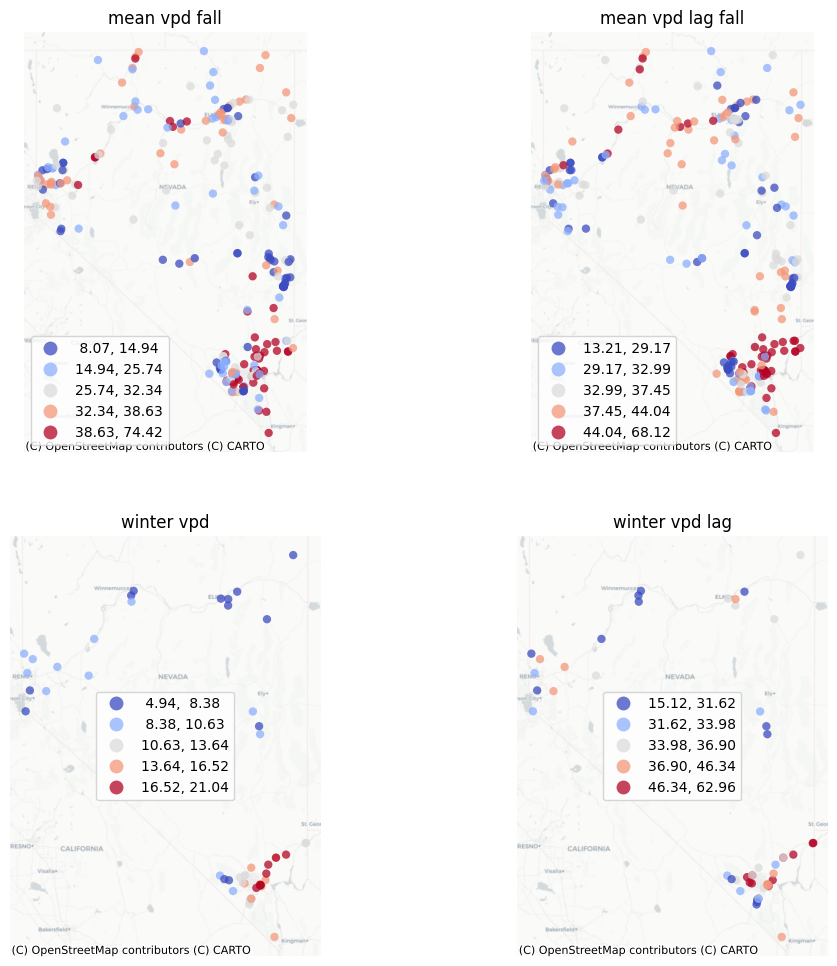

In [58]:
f, axs = plt.subplots(2, 2, figsize=(12, 12))

fall.plot(
    column="mean_vpd",
    cmap="coolwarm",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][0],
)
axs[0][0].set_axis_off()
axs[0][0].set_title("mean vpd fall")
cx.add_basemap(
    axs[0][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)
fall.plot(
    column="mean_vpd_lag",
    cmap='coolwarm',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[0][1],
)
axs[0][1].set_axis_off()
axs[0][1].set_title("mean vpd lag fall")
cx.add_basemap(
    axs[0][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

winter.plot(
    column="mean_vpd",
    cmap='coolwarm',
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][0],
)
axs[1][0].set_axis_off()
axs[1][0].set_title("winter vpd")
cx.add_basemap(
    axs[1][0],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

winter.plot(
    column="mean_vpd_lag",
    cmap='coolwarm',
    scheme='quantiles',
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=axs[1][1],
)
axs[1][1].set_axis_off()
axs[1][1].set_title("winter vpd lag")
cx.add_basemap(
    axs[1][1],
    crs=wild_fire_all.crs,
    source=cx.providers.CartoDB.Positron,
)

plt.show()

Moran's Plot and Moran's I

In [59]:
#standardizing mean temperature values and finding lag

wildfire_df_20['mean_temp_std']=wildfire_df_20['mean_temp']-wildfire_df_20['mean_temp'].mean()
wildfire_df_20['mean_temp_std_lag']=weights.spatial_lag.lag_spatial(w_20,wildfire_df_20['mean_temp_std'])

wildfire_df_21['mean_temp_std']=wildfire_df_21['mean_temp']-wildfire_df_21['mean_temp'].mean()
wildfire_df_21['mean_temp_std_lag']=weights.spatial_lag.lag_spatial(w_21,wildfire_df_21['mean_temp_std'])

wildfire_df_22['mean_temp_std']=wildfire_df_22['mean_temp']-wildfire_df_22['mean_temp'].mean()
wildfire_df_22['mean_temp_std_lag']=weights.spatial_lag.lag_spatial(w_22,wildfire_df_22['mean_temp_std'])


In [60]:
wildfire_df_20.head(3)

,Fire_Name,Acres,District,Day,Month,Year,geometry,State,County,mean_temp,mean_prec,mean_vpd,mean_temp_lag,mean_prec_lag,mean_vpd_lag,mean_temp_std,mean_temp_std_lag
22938,Ophir,0.2,Carson City District,12,1,2020,POINT (-119.84711 39.29871),NV,Washoe,0,6.86,7.003,19.625,4.746500,29.747125,-20.914286,-1.289286
22818,CCFD1- WETLANDS -SND PROTECTION,0.1,Southern Nevada District,21,1,2020,POINT (-115.00271 36.08757),NV,Clark,13,0.00,14.002,27.750,6.111000,56.090876,-7.914286,6.835714
22939,Poeville,69.0,Carson City District,1,2,2020,POINT (-119.90181 39.58441),NV,Washoe,7,0.07,9.098,20.375,4.127125,33.768500,-13.914286,-0.539286


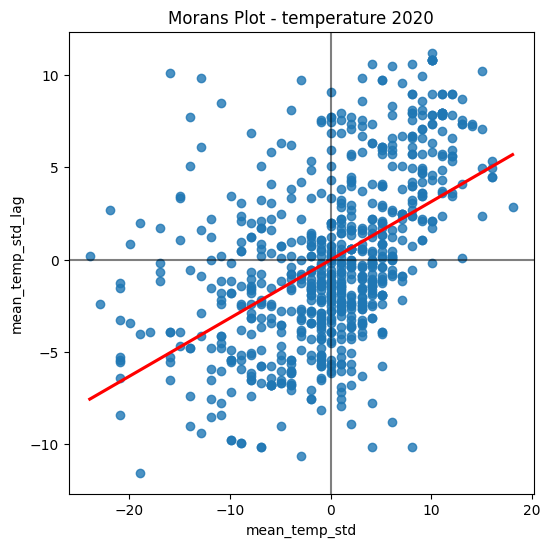

In [61]:
f,ax=plt.subplots(1,figsize=(6,6))

seaborn.regplot(wildfire_df_20,x='mean_temp_std',y='mean_temp_std_lag',line_kws={"color":'r'},ci=None)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Morans Plot - temperature 2020")

plt.show()

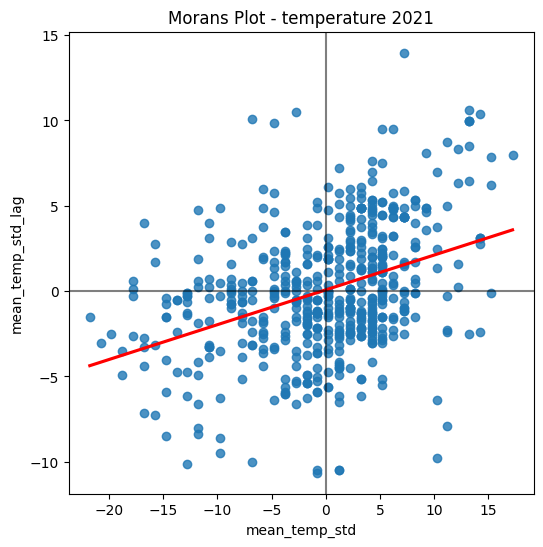

In [62]:
f,ax=plt.subplots(1,figsize=(6,6))

seaborn.regplot(wildfire_df_21,x='mean_temp_std',y='mean_temp_std_lag',line_kws={"color":'r'},ci=None)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Morans Plot - temperature 2021")

plt.show()

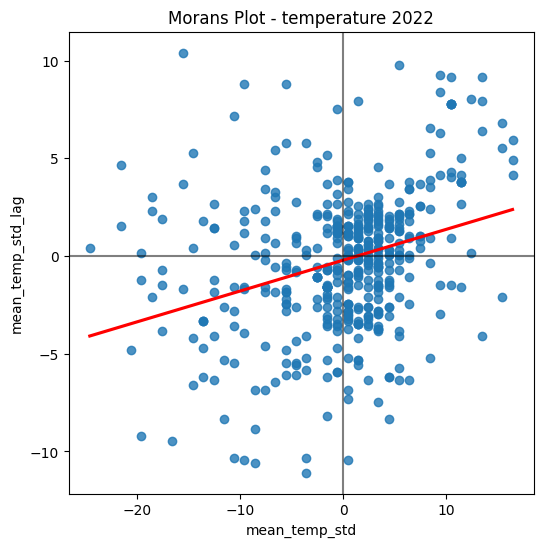

In [63]:
f,ax=plt.subplots(1,figsize=(6,6))

seaborn.regplot(wildfire_df_22,x='mean_temp_std',y='mean_temp_std_lag',line_kws={"color":'r'},ci=None)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Morans Plot - temperature 2022")

plt.show()

In [64]:
moran20=esda.moran.Moran(wildfire_df_20['mean_temp'],w_20)
moran21=esda.moran.Moran(wildfire_df_21['mean_temp'],w_21)
moran22=esda.moran.Moran(wildfire_df_22['mean_temp'],w_22)

In [65]:
#moran's I
print(f"Moran's I-2020: {moran20.I}")
print(f"Moran's pseudu p-value 2020: {moran20.p_sim}")

print(f"\nMoran's I-2021: {moran21.I}")
print(f"Moran's pseudu p-value 2021: {moran21.p_sim}")

print(f"\nMoran's I-2022: {moran22.I}")
print(f"Moran's pseudu p-value 2022: {moran22.p_sim}")


Moran's I-2020: 0.31533748496982467
Moran's pseudu p-value 2020: 0.001

Moran's I-2021: 0.20417251589827115
Moran's pseudu p-value 2021: 0.001

Moran's I-2022: 0.15794166551821956
Moran's pseudu p-value 2022: 0.001


(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.32', ylabel='Density'>,
        <Axes: title={'center': 'Moran Scatterplot (0.32)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

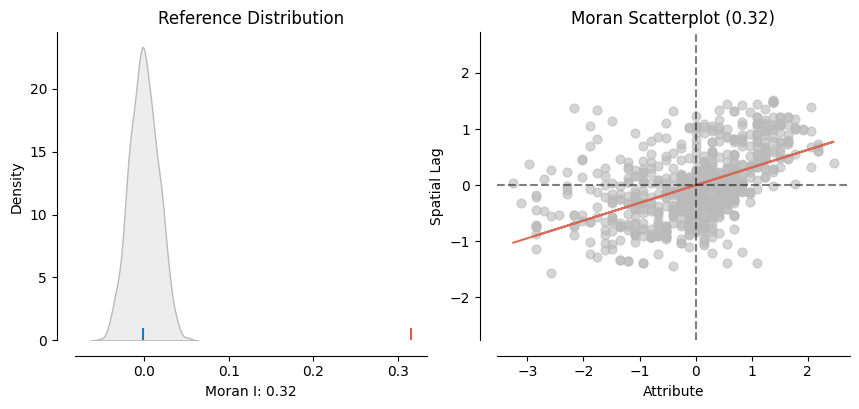

In [66]:
plot_moran(moran20)

(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.2', ylabel='Density'>,
        <Axes: title={'center': 'Moran Scatterplot (0.2)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

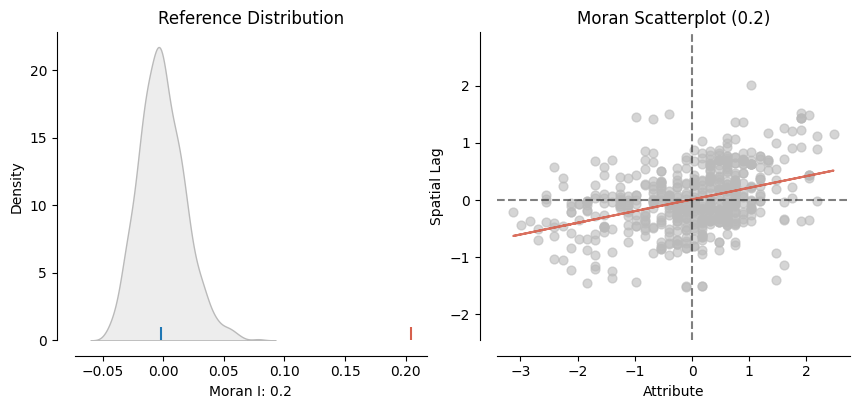

In [67]:
plot_moran(moran21)

(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.16', ylabel='Density'>,
        <Axes: title={'center': 'Moran Scatterplot (0.16)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

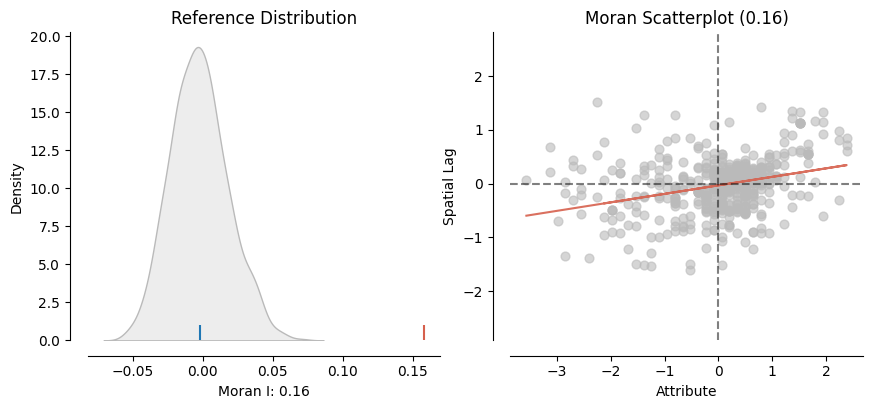

In [68]:
plot_moran(moran22)

In [69]:
#standardizing mean precipitation values and finding lag

wildfire_df_20['mean_prec_std']=wildfire_df_20['mean_prec']-wildfire_df_20['mean_prec'].mean()
wildfire_df_20['mean_prec_std_lag']=weights.spatial_lag.lag_spatial(w_20,wildfire_df_20['mean_prec_std'])

wildfire_df_21['mean_prec_std']=wildfire_df_21['mean_prec']-wildfire_df_21['mean_prec'].mean()
wildfire_df_21['mean_prec_std_lag']=weights.spatial_lag.lag_spatial(w_21,wildfire_df_21['mean_prec_std'])

wildfire_df_22['mean_prec_std']=wildfire_df_22['mean_prec']-wildfire_df_22['mean_prec'].mean()
wildfire_df_22['mean_prec_std_lag']=weights.spatial_lag.lag_spatial(w_22,wildfire_df_22['mean_prec_std'])


In [70]:
wildfire_df_20.head(3)

,Fire_Name,Acres,District,Day,Month,Year,geometry,State,County,mean_temp,mean_prec,mean_vpd,mean_temp_lag,mean_prec_lag,mean_vpd_lag,mean_temp_std,mean_temp_std_lag,mean_prec_std,mean_prec_std_lag
22938,Ophir,0.2,Carson City District,12,1,2020,POINT (-119.84711 39.29871),NV,Washoe,0,6.86,7.003,19.625,4.746500,29.747125,-20.914286,-1.289286,1.840016,-0.273484
22818,CCFD1- WETLANDS -SND PROTECTION,0.1,Southern Nevada District,21,1,2020,POINT (-115.00271 36.08757),NV,Clark,13,0.00,14.002,27.750,6.111000,56.090876,-7.914286,6.835714,-5.019984,1.091016
22939,Poeville,69.0,Carson City District,1,2,2020,POINT (-119.90181 39.58441),NV,Washoe,7,0.07,9.098,20.375,4.127125,33.768500,-13.914286,-0.539286,-4.949984,-0.892859


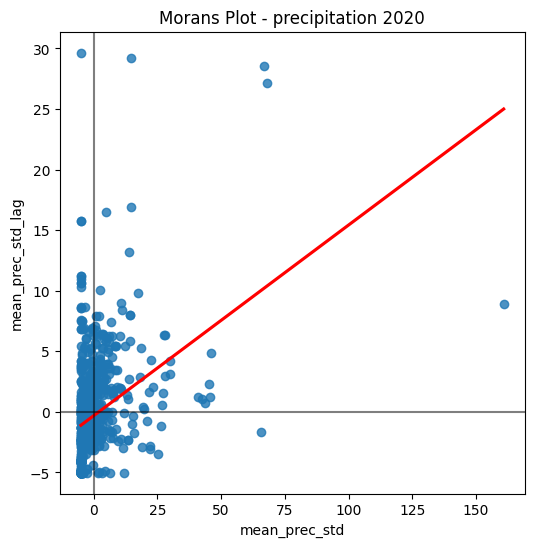

In [71]:
f,ax=plt.subplots(1,figsize=(6,6))

seaborn.regplot(wildfire_df_20,x='mean_prec_std',y='mean_prec_std_lag',line_kws={"color":'r'},ci=None)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Morans Plot - precipitation 2020")
plt.show()

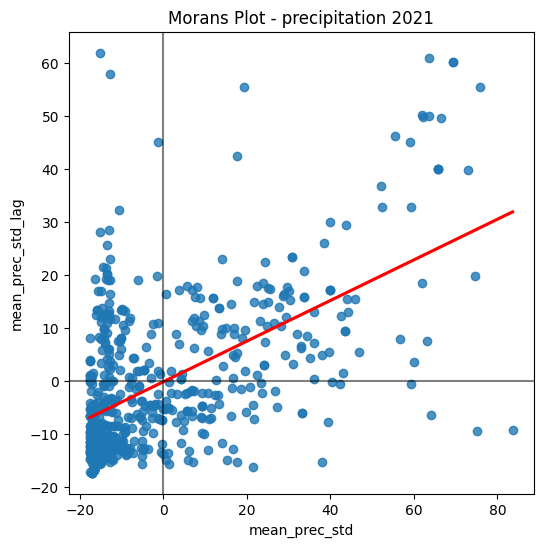

In [72]:
f,ax=plt.subplots(1,figsize=(6,6))

seaborn.regplot(wildfire_df_21,x='mean_prec_std',y='mean_prec_std_lag',line_kws={"color":'r'},ci=None)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Morans Plot - precipitation 2021")

plt.show()

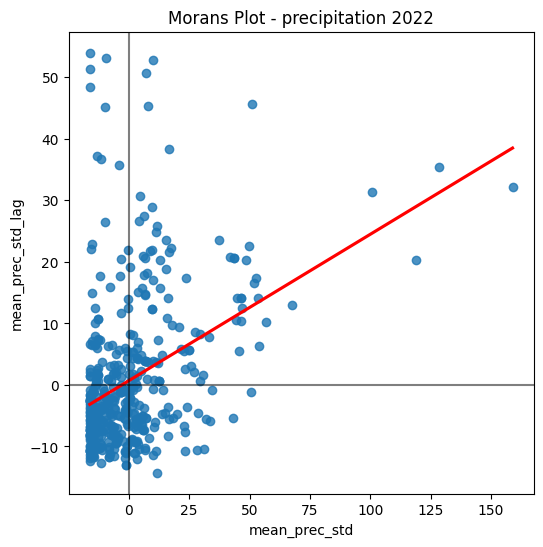

In [73]:
f,ax=plt.subplots(1,figsize=(6,6))

seaborn.regplot(wildfire_df_22,x='mean_prec_std',y='mean_prec_std_lag',line_kws={"color":'r'},ci=None)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Morans Plot - precipitation 2022")

plt.show()

In [74]:
#finding moran's I for precipitation
moran20_p=esda.moran.Moran(wildfire_df_20['mean_prec'],w_20)
moran21_p=esda.moran.Moran(wildfire_df_21['mean_prec'],w_21)
moran22_p=esda.moran.Moran(wildfire_df_22['mean_prec'],w_22)

In [75]:
#moran's I
print(f"Moran's I-2020: {moran20_p.I}")
print(f"Moran's pseudu p-value 2020: {moran20_p.p_sim}")

print(f"\nMoran's I-2021: {moran21_p.I}")
print(f"Moran's pseudu p-value 2021: {moran21_p.p_sim}")

print(f"\nMoran's I-2022: {moran22_p.I}")
print(f"Moran's pseudu p-value 2022: {moran22_p.p_sim}")


Moran's I-2020: 0.1573672117753865
Moran's pseudu p-value 2020: 0.001

Moran's I-2021: 0.3835363458426819
Moran's pseudu p-value 2021: 0.001

Moran's I-2022: 0.23804250203704108
Moran's pseudu p-value 2022: 0.001


(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.24', ylabel='Density'>,
        <Axes: title={'center': 'Moran Scatterplot (0.24)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

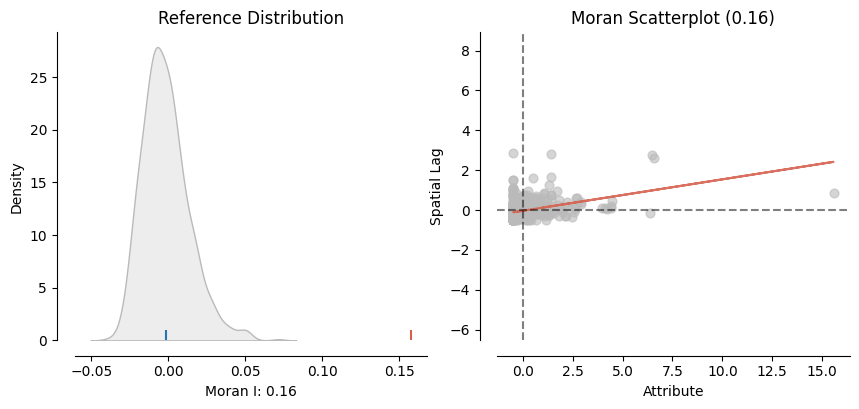

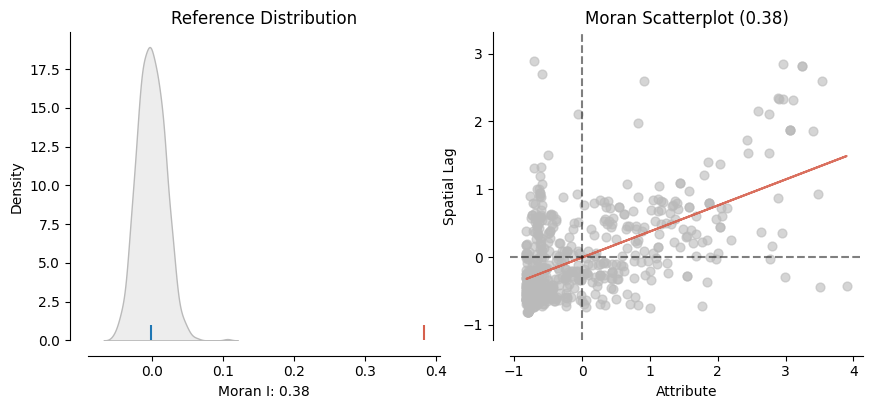

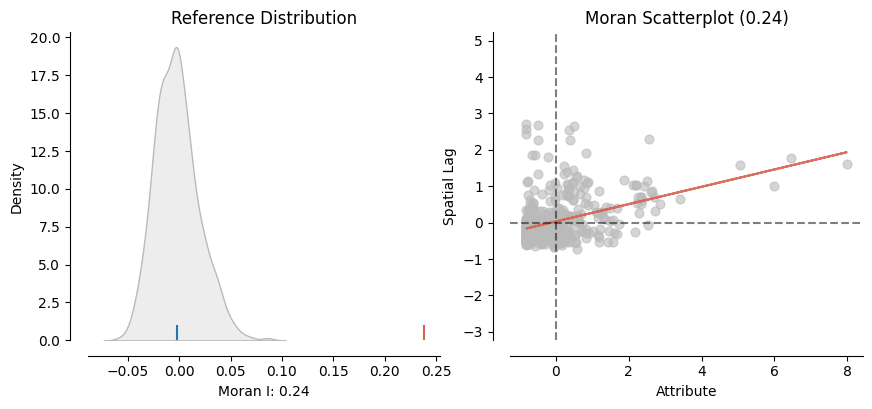

In [76]:
plot_moran(moran20_p)
plot_moran(moran21_p)
plot_moran(moran22_p)

In [77]:
#standardizing mean precipitation values and finding lag

wildfire_df_20['mean_vpd_std']=wildfire_df_20['mean_vpd']-wildfire_df_20['mean_vpd'].mean()
wildfire_df_20['mean_vpd_std_lag']=weights.spatial_lag.lag_spatial(w_20,wildfire_df_20['mean_vpd_std'])

wildfire_df_21['mean_vpd_std']=wildfire_df_21['mean_vpd']-wildfire_df_21['mean_vpd'].mean()
wildfire_df_21['mean_vpd_std_lag']=weights.spatial_lag.lag_spatial(w_21,wildfire_df_21['mean_vpd_std'])

wildfire_df_22['mean_vpd_std']=wildfire_df_22['mean_vpd']-wildfire_df_22['mean_vpd'].mean()
wildfire_df_22['mean_vpd_std_lag']=weights.spatial_lag.lag_spatial(w_22,wildfire_df_22['mean_vpd_std'])


In [78]:
wildfire_df_20.head(2)

,Fire_Name,Acres,District,Day,Month,Year,geometry,State,County,mean_temp,...,mean_vpd,mean_temp_lag,mean_prec_lag,mean_vpd_lag,mean_temp_std,mean_temp_std_lag,mean_prec_std,mean_prec_std_lag,mean_vpd_std,mean_vpd_std_lag
22938,Ophir,0.2,Carson City District,12,1,2020,POINT (-119.84711 39.29871),NV,Washoe,0,...,7.003,19.625,4.7465,29.747125,-20.914286,-1.289286,1.840016,-0.273484,-32.555426,-9.811301
22818,CCFD1- WETLANDS -SND PROTECTION,0.1,Southern Nevada District,21,1,2020,POINT (-115.00271 36.08757),NV,Clark,13,...,14.002,27.750,6.1110,56.090876,-7.914286,6.835714,-5.019984,1.091016,-25.556426,16.532450


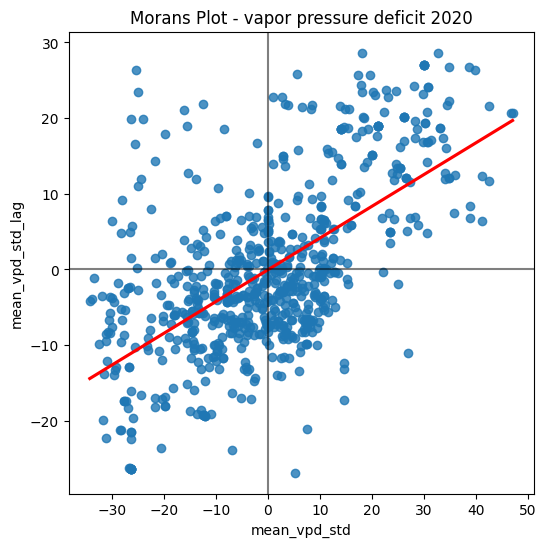

In [79]:
f,ax=plt.subplots(1,figsize=(6,6))

seaborn.regplot(wildfire_df_20,x='mean_vpd_std',y='mean_vpd_std_lag',line_kws={"color":'r'},ci=None)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Morans Plot - vapor pressure deficit 2020")
plt.show()

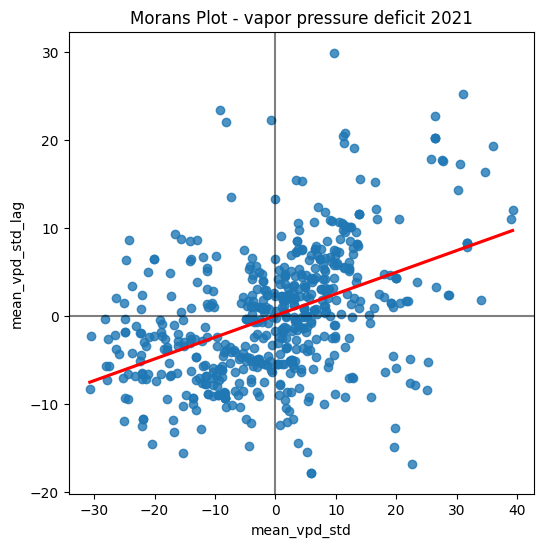

In [80]:
f,ax=plt.subplots(1,figsize=(6,6))

seaborn.regplot(wildfire_df_21,x='mean_vpd_std',y='mean_vpd_std_lag',line_kws={"color":'r'},ci=None)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Morans Plot - vapor pressure deficit 2021")
plt.show()

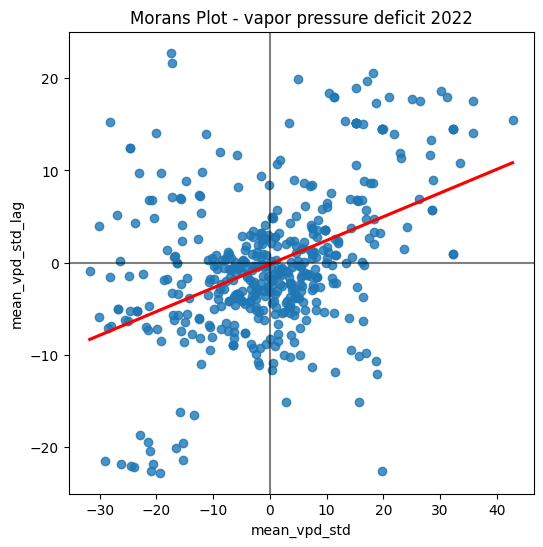

In [81]:
f,ax=plt.subplots(1,figsize=(6,6))

seaborn.regplot(wildfire_df_22,x='mean_vpd_std',y='mean_vpd_std_lag',line_kws={"color":'r'},ci=None)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Morans Plot - vapor pressure deficit 2022")
plt.show()

In [82]:
#finding moran's I for vapor pressure deficit
moran20_v=esda.moran.Moran(wildfire_df_20['mean_vpd'],w_20)
moran21_v=esda.moran.Moran(wildfire_df_21['mean_vpd'],w_21)
moran22_v=esda.moran.Moran(wildfire_df_22['mean_vpd'],w_22)

In [83]:
#moran's I
print(f"Moran's I-2020: {moran20_v.I}")
print(f"Moran's pseudu p-value 2020: {moran20_v.p_sim}")

print(f"\nMoran's I-2021: {moran21_v.I}")
print(f"Moran's pseudu p-value 2021: {moran21_v.p_sim}")

print(f"\nMoran's I-2022: {moran22_v.I}")
print(f"Moran's pseudu p-value 2022: {moran22_v.p_sim}")


Moran's I-2020: 0.41968590026525826
Moran's pseudu p-value 2020: 0.001

Moran's I-2021: 0.24629200513960914
Moran's pseudu p-value 2021: 0.001

Moran's I-2022: 0.2569289354310587
Moran's pseudu p-value 2022: 0.001


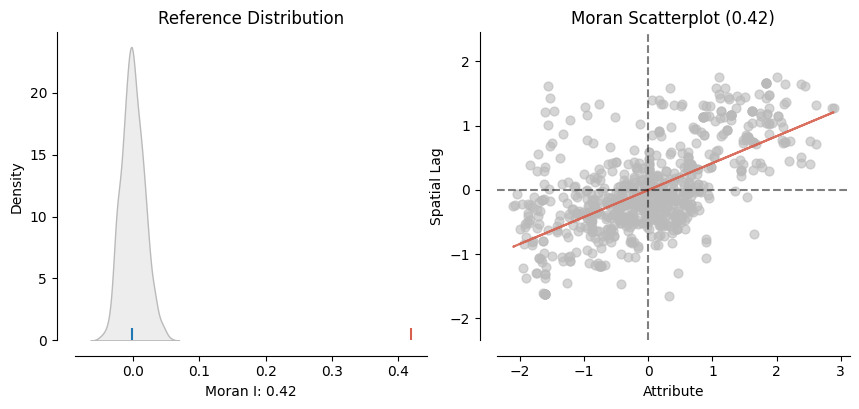

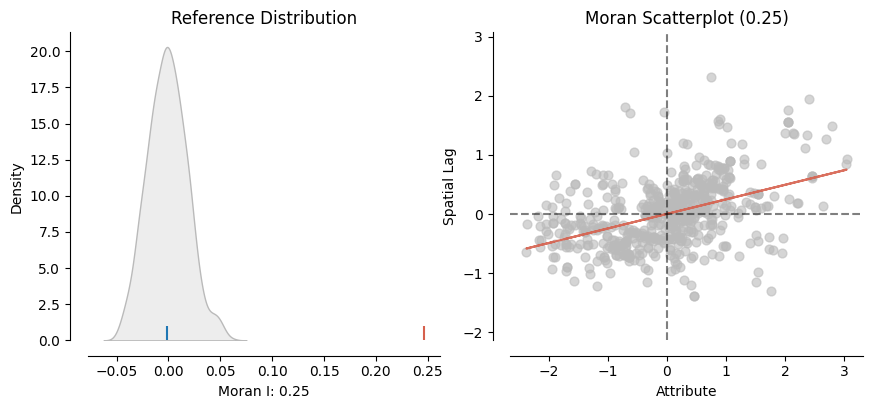

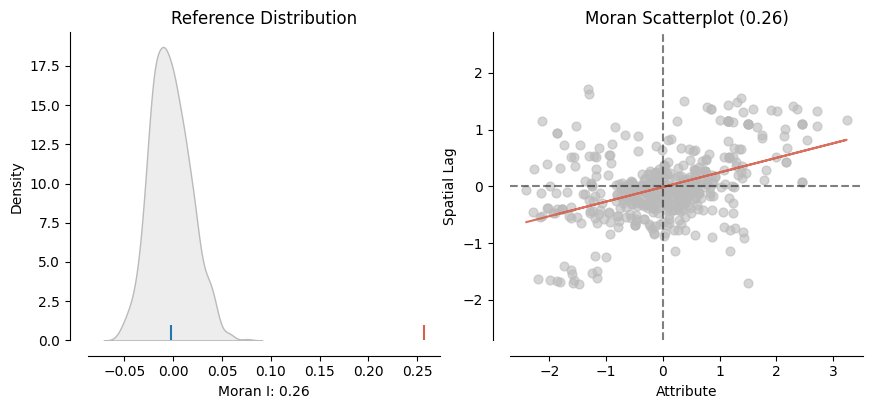

In [84]:
plot_moran(moran20_v)
plot_moran(moran21_v)
plot_moran(moran22_v)
plt.show()

local spatial auto-correlation

In [85]:
#local moran's I 
#temperature
lisa_t_20=esda.moran.Moran_Local(wildfire_df_20['mean_temp'],w_20)
lisa_t_21=esda.moran.Moran_Local(wildfire_df_21['mean_temp'],w_21)
lisa_t_22=esda.moran.Moran_Local(wildfire_df_22['mean_temp'],w_22)


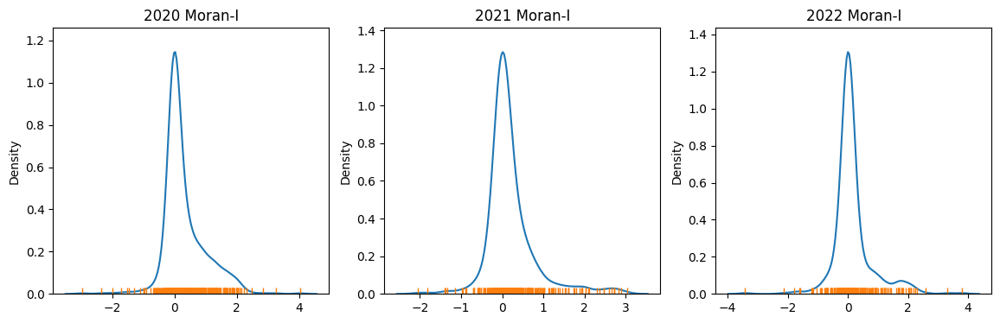

In [86]:
#temperature
f,axs=plt.subplots(1,3,figsize=(14,4))
axs=axs.flatten()
#2020
seaborn.kdeplot(lisa_t_20.Is,ax=axs[0])
seaborn.rugplot(lisa_t_20.Is,ax=axs[0])
axs[0].set_title("2020 Moran-I")
#2021
seaborn.kdeplot(lisa_t_21.Is,ax=axs[1])
seaborn.rugplot(lisa_t_21.Is,ax=axs[1])
axs[1].set_title("2021 Moran-I")
#2022
seaborn.kdeplot(lisa_t_22.Is,ax=axs[2])
seaborn.rugplot(lisa_t_22.Is,ax=axs[2])
axs[2].set_title("2022 Moran-I")
plt.show()

In [87]:
def display_clusters(lisa_t,df):
    f,axs=plt.subplots(2,2,figsize=(12,10))
    ax=axs.flatten()

    #plotting simple choropleth for Moran's Is
    df.assign(Is_t=lisa_t.Is).plot(
        column='Is_t',
        cmap="plasma",
        scheme="quantiles",
        k=5,
        edgecolor="white",
        linewidth=0.1,
        alpha=0.75,
        legend=True,
        ax=ax[0],
    )
    cx.add_basemap(ax=ax[0],crs=df.crs,source=cx.providers.Esri.WorldTerrain)

    ax[0].set_axis_off()
    ax[0].set_title("Local Statistic-Moran's I")


    #plotting choropleth for classifying statistic values in 4 quandrants
    esdaplot.lisa_cluster(lisa_t,df,p=1,ax=ax[1])
    cx.add_basemap(ax=ax[1],crs=df.crs,source=cx.providers.Esri.WorldTerrain)
    ax[1].set_title('Scatterplot Quandrant')

    labels = pd.Series(
        1*(lisa_t.p_sim < 0.05), 
        index=df.index
    ).map({1: "Significant", 0: "Non-Significant"})

    #plotting choropleth for significant and non-significant
    df.assign(cl=labels).plot(
        column='cl',
        categorical=True,
        k=2,
        cmap="Paired",
        linewidth=0.1,
        edgecolor="white",
        legend=True,
        ax=ax[2],
    )
    cx.add_basemap(ax=ax[2],crs=df.crs,source=cx.providers.Esri.WorldTerrain)
    ax[2].set_axis_off()
    ax[2].set_title("Statistical Significance")

    #combining 2 and 3 map
    esdaplot.lisa_cluster(lisa_t, df, p=0.05, ax=ax[3])
    cx.add_basemap(ax=ax[3],crs=df.crs,source=cx.providers.Esri.WorldTerrain)
    ax[3].set_title("Moran Cluster Map")

    f.tight_layout()
    plt.show()

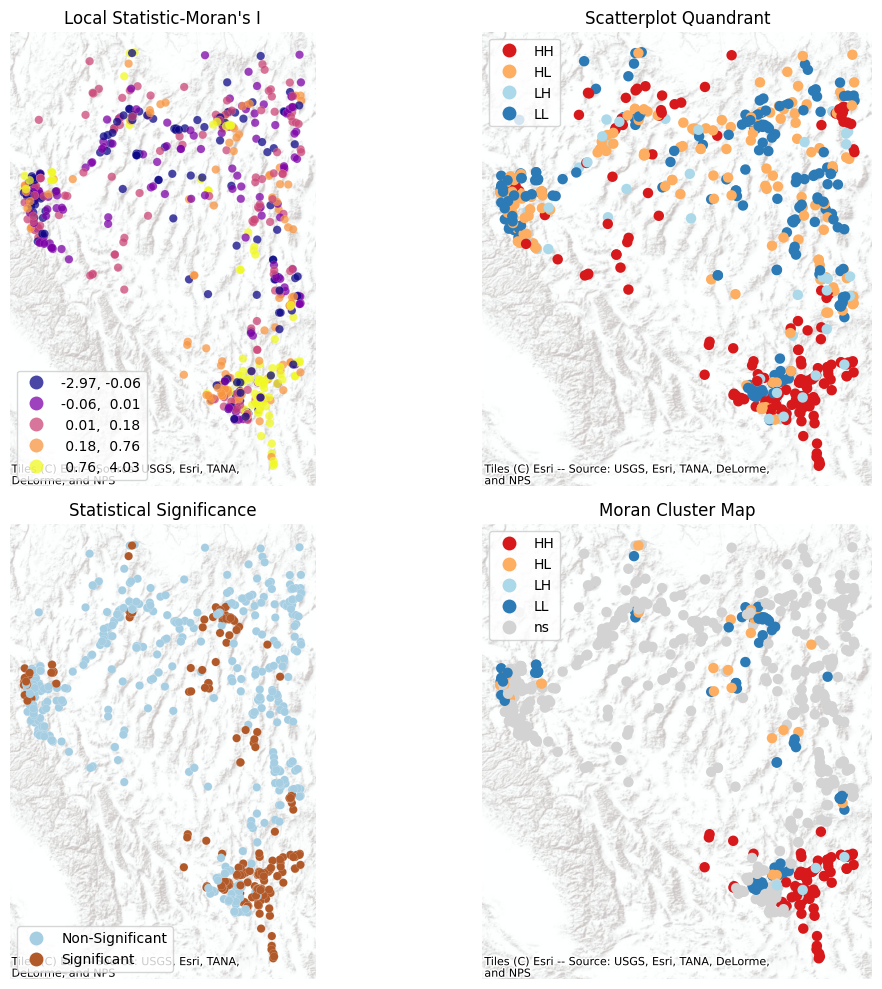

In [88]:
#moran clusters for 2020
display_clusters(lisa_t=lisa_t_20,df=wildfire_df_20)

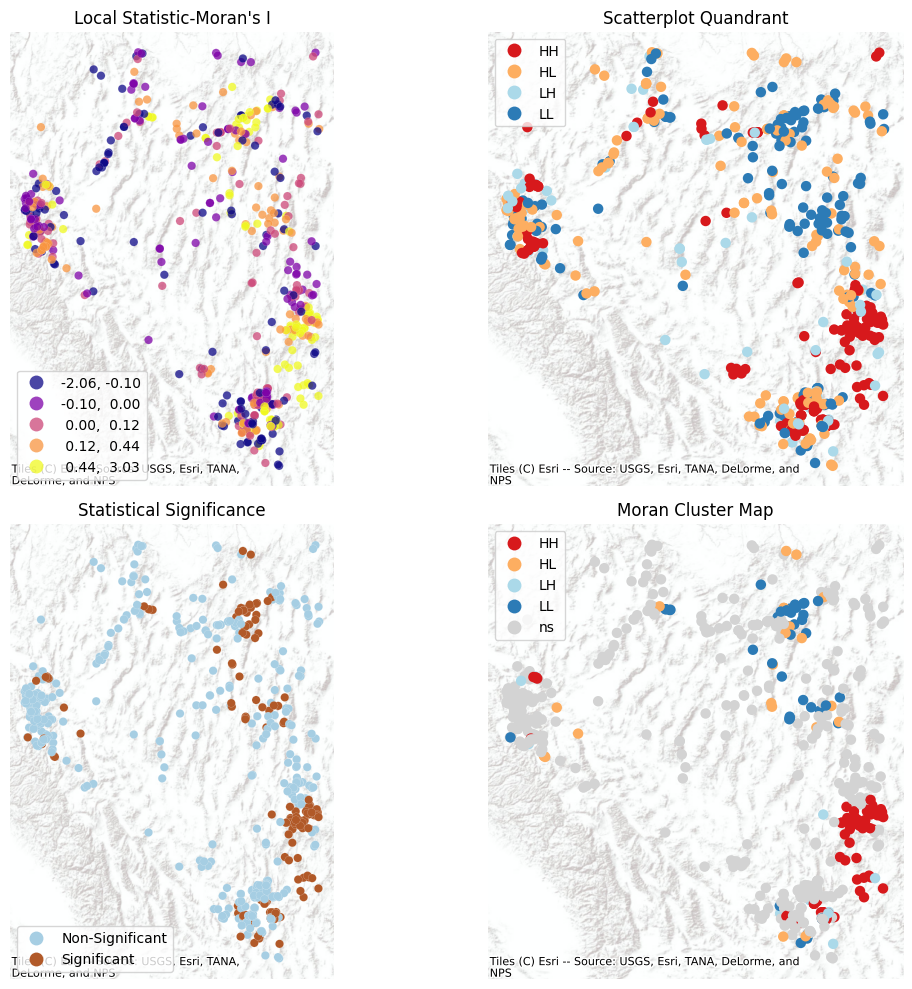

In [89]:
display_clusters(lisa_t=lisa_t_21,df=wildfire_df_21)

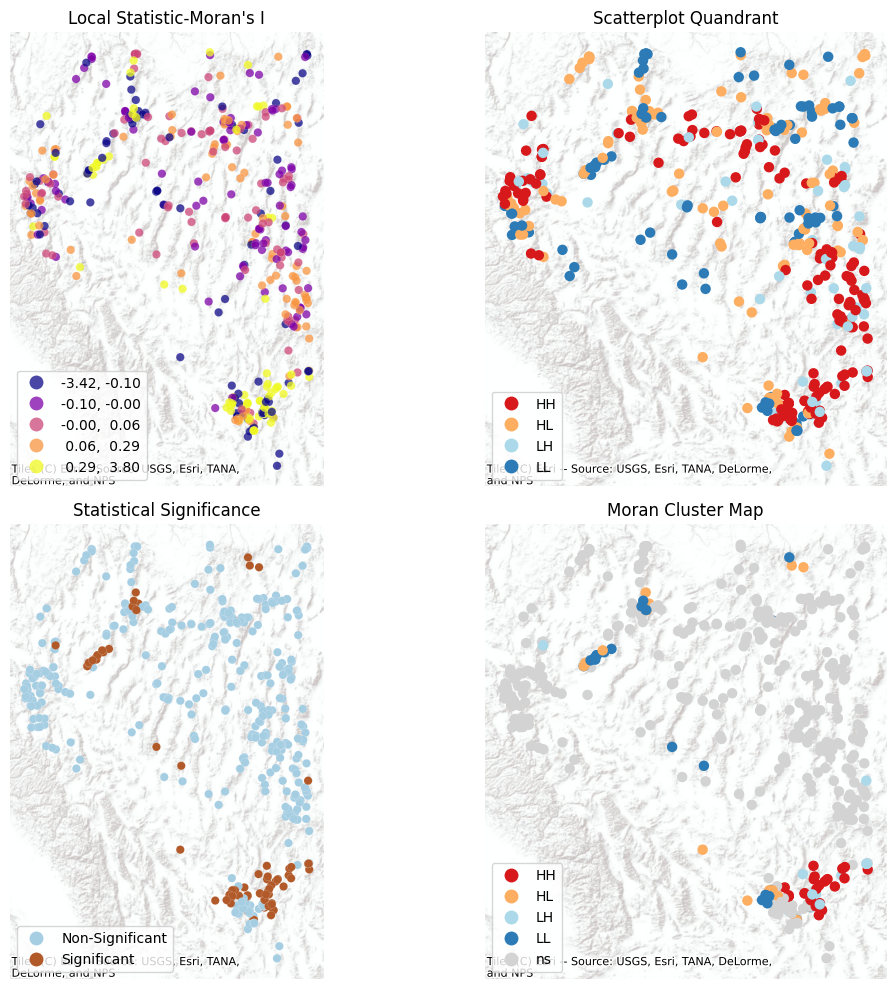

In [90]:
display_clusters(lisa_t=lisa_t_22,df=wildfire_df_22)

In [91]:
print(f"quandrant information : {lisa_t_20.q[:10]}")
print(f"quandrant information : {lisa_t_21.q[:10]}")
print(f"quandrant information : {lisa_t_22.q[:10]}")

quandrant information : [3 2 3 3 2 2 2 3 2 3]
quandrant information : [3 2 3 3 3 3 3 3 2 3]
quandrant information : [2 3 2 3 2 2 2 3 2 2]


In [92]:
#counting no. of obs in each quandrant
#2020
count=pd.value_counts(lisa_t_20.q)
count

1    248
3    224
4    185
2     78
Name: count, dtype: int64

In [93]:
#2021
count=pd.value_counts(lisa_t_21.q)
count

1    183
3    168
4    149
2     73
Name: count, dtype: int64

In [94]:
#2022
count=pd.value_counts(lisa_t_22.q)
count

1    164
4    117
3    116
2     75
Name: count, dtype: int64

In [95]:
#proportion on values that are significant
print(f"significant clusters proportion 2020: {(lisa_t_20.p_sim < 0.05).sum() * 100 / len(lisa_t_20.p_sim)}")
print(f"significant clusters proportion 2021: {(lisa_t_21.p_sim < 0.05).sum() * 100 / len(lisa_t_21.p_sim)}")
print(f"significant clusters proportion 2022: {(lisa_t_22.p_sim < 0.05).sum() * 100 / len(lisa_t_22.p_sim)}")

significant clusters proportion 2020: 35.374149659863946
significant clusters proportion 2021: 29.668411867364746
significant clusters proportion 2022: 20.127118644067796


In [96]:
#assigning p values and significance to dataframes
wildfire_df_20['p_sim']=lisa_t_20.p_sim
sig_20=1*(lisa_t_20.p_sim<0.05)
wildfire_df_20['sig']=sig_20

wildfire_df_21['p_sim']=lisa_t_21.p_sim
sig_21=1*(lisa_t_21.p_sim<0.05)
wildfire_df_21['sig']=sig_21

wildfire_df_22['p_sim']=lisa_t_22.p_sim
sig_22=1*(lisa_t_22.p_sim<0.05)
wildfire_df_22['sig']=sig_22

wildfire_df_20[['p_sim','sig']].head(5)

,p_sim,sig
22938,0.303,0
22818,0.003,1
22939,0.366,0
23029,0.041,1
23042,0.002,1


In [97]:
#assign cluster labels to df
spots=lisa_t_20.q*sig_20
spots_labels={
    0:"non-significant",
    1:"HH",
    2:"LH",
    3:"LL",
    4:"HL"
}

wildfire_df_20['cl_t']=pd.Series(data=spots,index=wildfire_df_20.index).map(spots_labels)
wildfire_df_20[['cl_t']].head(5)

,cl_t
22938,non-significant
22818,LH
22939,non-significant
23029,LL
23042,LH


In [98]:
#assign cluster labels to df
spots=lisa_t_21.q*sig_21
spots_labels={
    0:"non-significant",
    1:"HH",
    2:"LH",
    3:"LL",
    4:"HL"
}

wildfire_df_21['cl_t']=pd.Series(data=spots,index=wildfire_df_21.index).map(spots_labels)
wildfire_df_21[['cl_t']].head(5)

,cl_t
23468,non-significant
23273,LH
23469,LL
24618,non-significant
23470,non-significant


In [99]:
#assign cluster labels to df
spots=lisa_t_22.q*sig_22
spots_labels={
    0:"non-significant",
    1:"HH",
    2:"LH",
    3:"LL",
    4:"HL"
}

wildfire_df_22['cl_t']=pd.Series(data=spots,index=wildfire_df_22.index).map(spots_labels)
wildfire_df_22[['cl_t']].head(5)

,cl_t
23618,non-significant
23597,non-significant
23598,non-significant
23811,non-significant
23573,non-significant


In [100]:
#2020
wildfire_df_20['cl_t'].value_counts()

cl_t
non-significant    475
HH                 122
LL                  95
HL                  26
LH                  17
Name: count, dtype: int64

In [101]:
wildfire_df_21['cl_t'].value_counts()

cl_t
non-significant    403
HH                  87
LL                  44
HL                  23
LH                  16
Name: count, dtype: int64

In [102]:
wildfire_df_22['cl_t'].value_counts()

cl_t
non-significant    377
LL                  35
HH                  29
HL                  16
LH                  15
Name: count, dtype: int64

In [103]:
var=wildfire_df_20['mean_prec'].astype('float64')
wildfire_df_20['mean_prec']=var

var=wildfire_df_21['mean_prec'].astype('float64')
wildfire_df_21['mean_prec']=var

var=wildfire_df_22['mean_prec'].astype('float64')
wildfire_df_22['mean_prec']=var

In [104]:
#local moran's I 
#precipitation
lisa_p_20=esda.moran.Moran_Local(wildfire_df_20['mean_prec'],w_20)
lisa_p_21=esda.moran.Moran_Local(wildfire_df_21['mean_prec'],w_21)
lisa_p_22=esda.moran.Moran_Local(wildfire_df_22['mean_prec'],w_22)

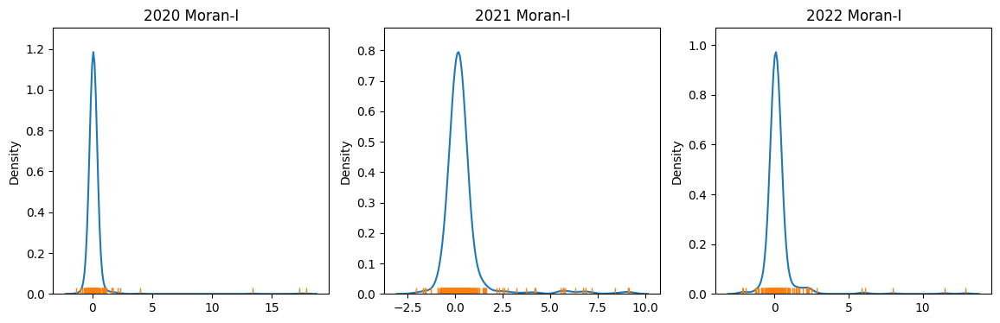

In [105]:
#precipitation
f,axs=plt.subplots(1,3,figsize=(14,4))
axs=axs.flatten()
#2020
seaborn.kdeplot(lisa_p_20.Is,ax=axs[0])
seaborn.rugplot(lisa_p_20.Is,ax=axs[0])
axs[0].set_title("2020 Moran-I")
#2021
seaborn.kdeplot(lisa_p_21.Is,ax=axs[1])
seaborn.rugplot(lisa_p_21.Is,ax=axs[1])
axs[1].set_title("2021 Moran-I")
#2022
seaborn.kdeplot(lisa_p_22.Is,ax=axs[2])
seaborn.rugplot(lisa_p_22.Is,ax=axs[2])
axs[2].set_title("2022 Moran-I")
plt.show()

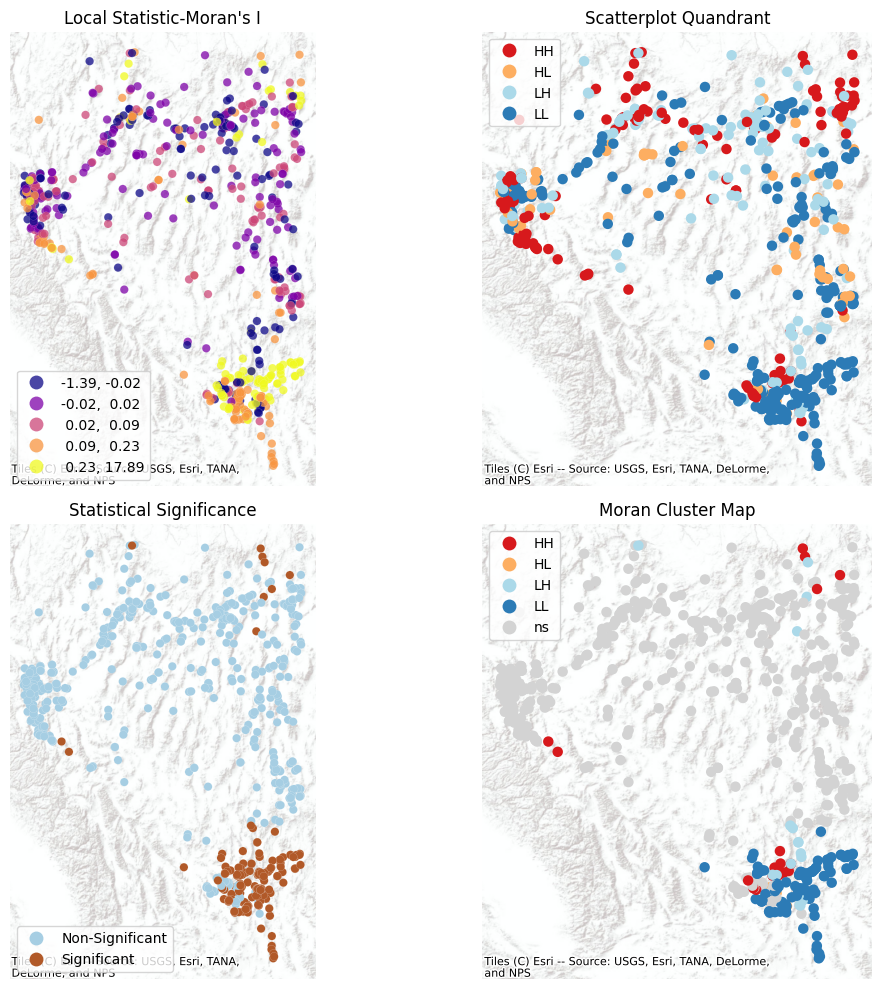

In [106]:
display_clusters(lisa_p_20,wildfire_df_20)

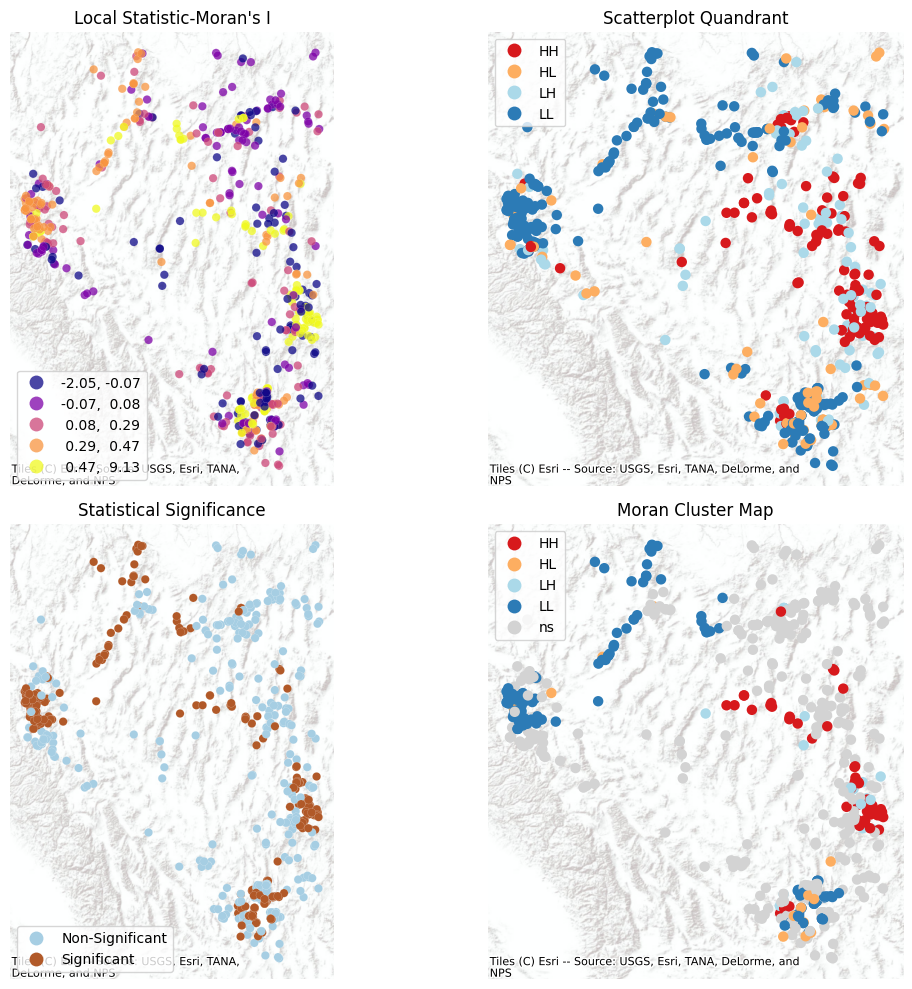

In [107]:
display_clusters(lisa_p_21,wildfire_df_21)

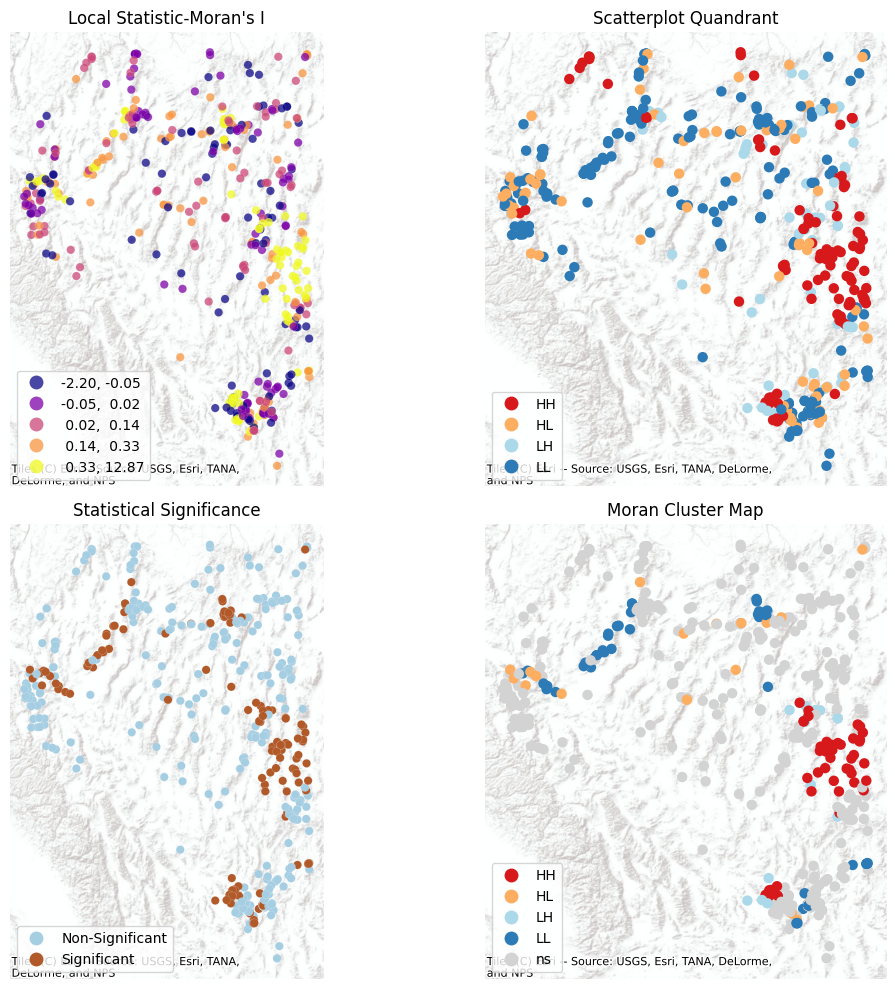

In [108]:
display_clusters(lisa_p_22,wildfire_df_22)

In [109]:
#counting no. of obs in each quandrant
#2020
count=pd.value_counts(lisa_p_20.q)
count

3    371
2    148
1    140
4     76
Name: count, dtype: int64

In [110]:
#counting no. of obs in each quandrant
#2021
count=pd.value_counts(lisa_p_21.q)
count

3    276
1    121
2    104
4     72
Name: count, dtype: int64

In [111]:
#counting no. of obs in each quandrant
#2022
count=pd.value_counts(lisa_p_22.q)
count

3    226
1    105
4     74
2     67
Name: count, dtype: int64

In [112]:
#proportion on values that are significant
print(f"significant clusters proportion 2020: {(lisa_p_20.p_sim < 0.05).sum() * 100 / len(lisa_p_20.p_sim)}")
print(f"significant clusters proportion 2021: {(lisa_p_21.p_sim < 0.05).sum() * 100 / len(lisa_p_21.p_sim)}")
print(f"significant clusters proportion 2022: {(lisa_p_22.p_sim < 0.05).sum() * 100 / len(lisa_p_22.p_sim)}")

significant clusters proportion 2020: 31.700680272108844
significant clusters proportion 2021: 41.361256544502616
significant clusters proportion 2022: 29.872881355932204


In [113]:
#assigning p values and significance to dataframes
wildfire_df_20['p_sim_prec']=lisa_p_20.p_sim
sig_20=1*(lisa_p_20.p_sim<0.05)
wildfire_df_20['sig_prec']=sig_20

wildfire_df_21['p_sim_prec']=lisa_p_21.p_sim
sig_21=1*(lisa_p_21.p_sim<0.05)
wildfire_df_21['sig_prec']=sig_21

wildfire_df_22['p_sim_prec']=lisa_p_22.p_sim
sig_22=1*(lisa_p_22.p_sim<0.05)
wildfire_df_22['sig_prec']=sig_22

wildfire_df_20[['p_sim_prec','sig_prec']].head(5)

,p_sim_prec,sig_prec
22938,0.424,0
22818,0.266,0
22939,0.488,0
23029,0.082,0
23042,0.001,1


In [114]:
#assign cluster labels to df
spots=lisa_p_20.q*sig_20


wildfire_df_20['cl_p']=pd.Series(data=spots,index=wildfire_df_20.index).map(spots_labels)
wildfire_df_20[['cl_p']].head(5)

,cl_p
22938,non-significant
22818,non-significant
22939,non-significant
23029,non-significant
23042,HL


In [115]:
#assign cluster labels to df
spots=lisa_p_21.q*sig_21


wildfire_df_21['cl_p']=pd.Series(data=spots,index=wildfire_df_21.index).map(spots_labels)
wildfire_df_21[['cl_p']].head(5)

,cl_p
23468,non-significant
23273,HH
23469,non-significant
24618,non-significant
23470,non-significant


In [116]:
#assign cluster labels to df
spots=lisa_p_22.q*sig_22

wildfire_df_22['cl_p']=pd.Series(data=spots,index=wildfire_df_22.index).map(spots_labels)
wildfire_df_22[['cl_p']].head(5)

,cl_p
23618,non-significant
23597,LL
23598,non-significant
23811,non-significant
23573,LL


In [117]:
#counting values in each cluster 2020
wildfire_df_20['cl_p'].value_counts()

cl_p
non-significant    502
LL                 184
LH                  23
HH                  20
HL                   6
Name: count, dtype: int64

In [118]:
#2021
wildfire_df_21['cl_p'].value_counts()

cl_p
non-significant    336
LL                 142
HH                  60
LH                  21
HL                  14
Name: count, dtype: int64

In [119]:
#2022
wildfire_df_22['cl_p'].value_counts()

cl_p
non-significant    331
LL                  56
HH                  48
LH                  19
HL                  18
Name: count, dtype: int64

In [120]:
wildfire_df_20.head(3)

,Fire_Name,Acres,District,Day,Month,Year,geometry,State,County,mean_temp,...,mean_prec_std,mean_prec_std_lag,mean_vpd_std,mean_vpd_std_lag,p_sim,sig,cl_t,p_sim_prec,sig_prec,cl_p
22938,Ophir,0.2,Carson City District,12,1,2020,POINT (-119.84711 39.29871),NV,Washoe,0,...,1.840016,-0.273484,-32.555426,-9.811301,0.303,0,non-significant,0.424,0,non-significant
22818,CCFD1- WETLANDS -SND PROTECTION,0.1,Southern Nevada District,21,1,2020,POINT (-115.00271 36.08757),NV,Clark,13,...,-5.019984,1.091016,-25.556426,16.532450,0.003,1,LH,0.266,0,non-significant
22939,Poeville,69.0,Carson City District,1,2,2020,POINT (-119.90181 39.58441),NV,Washoe,7,...,-4.949984,-0.892859,-30.460426,-5.789926,0.366,0,non-significant,0.488,0,non-significant


In [121]:
#local moran's I 
#vapor pressure deficit
lisa_v_20=esda.moran.Moran_Local(wildfire_df_20['mean_vpd'],w_20)
lisa_v_21=esda.moran.Moran_Local(wildfire_df_21['mean_vpd'],w_21)
lisa_v_22=esda.moran.Moran_Local(wildfire_df_22['mean_vpd'],w_22)

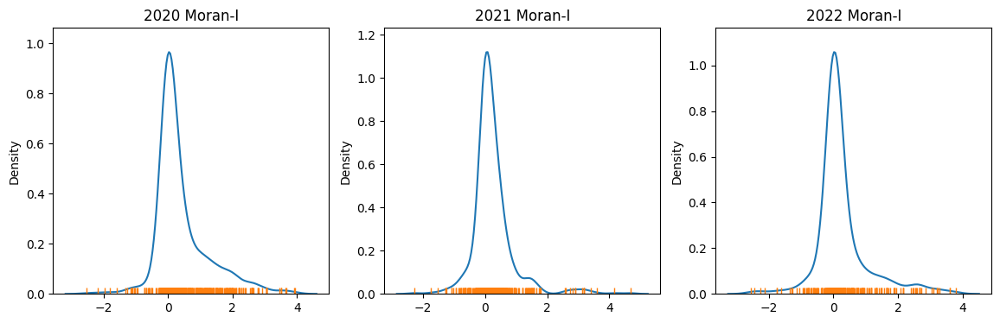

In [122]:
#vpd
f,axs=plt.subplots(1,3,figsize=(14,4))
axs=axs.flatten()
#2020
seaborn.kdeplot(lisa_v_20.Is,ax=axs[0])
seaborn.rugplot(lisa_v_20.Is,ax=axs[0])
axs[0].set_title("2020 Moran-I")
#2021
seaborn.kdeplot(lisa_v_21.Is,ax=axs[1])
seaborn.rugplot(lisa_v_21.Is,ax=axs[1])
axs[1].set_title("2021 Moran-I")
#2022
seaborn.kdeplot(lisa_v_22.Is,ax=axs[2])
seaborn.rugplot(lisa_v_22.Is,ax=axs[2])
axs[2].set_title("2022 Moran-I")
plt.show()

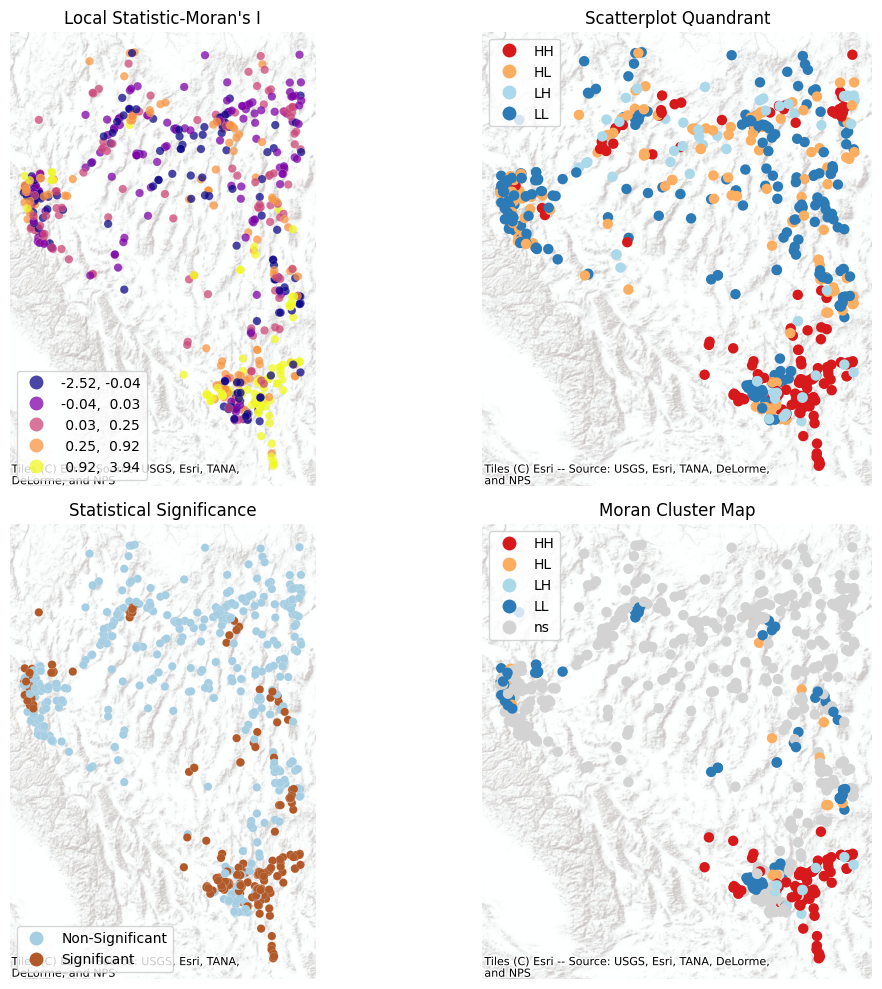

In [123]:
display_clusters(lisa_v_20,wildfire_df_20)

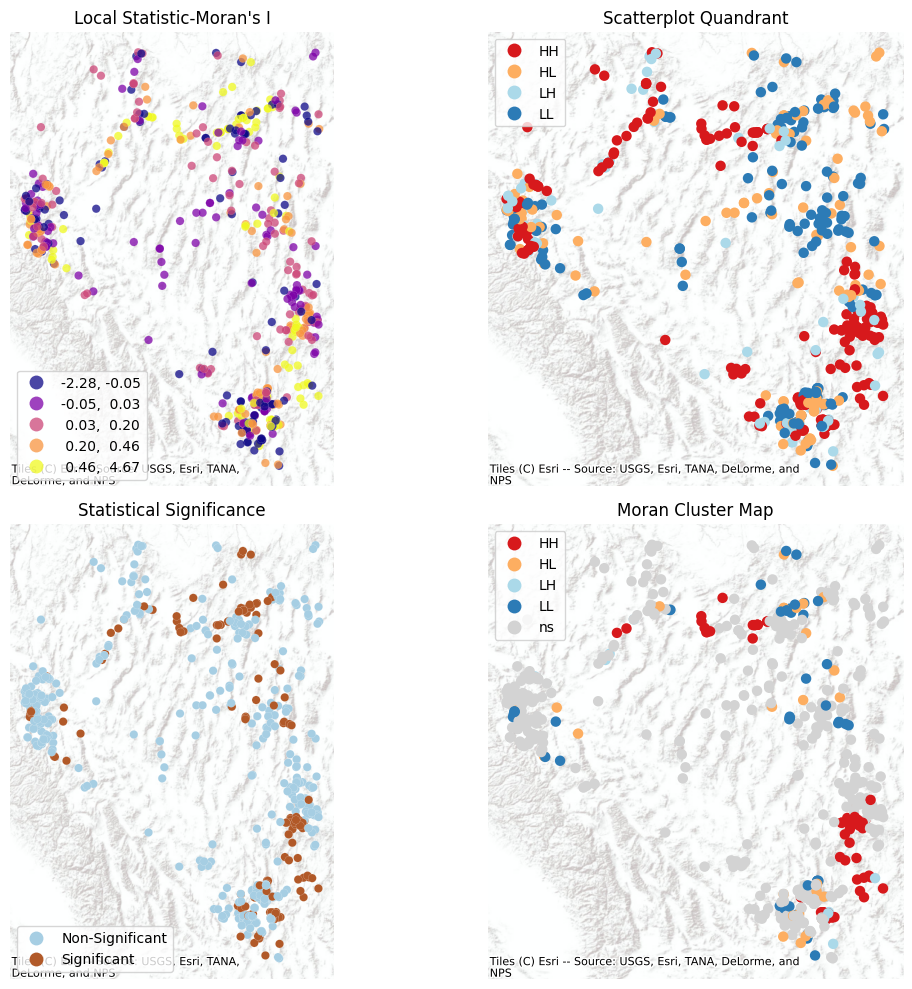

In [124]:
display_clusters(lisa_v_21,wildfire_df_21)

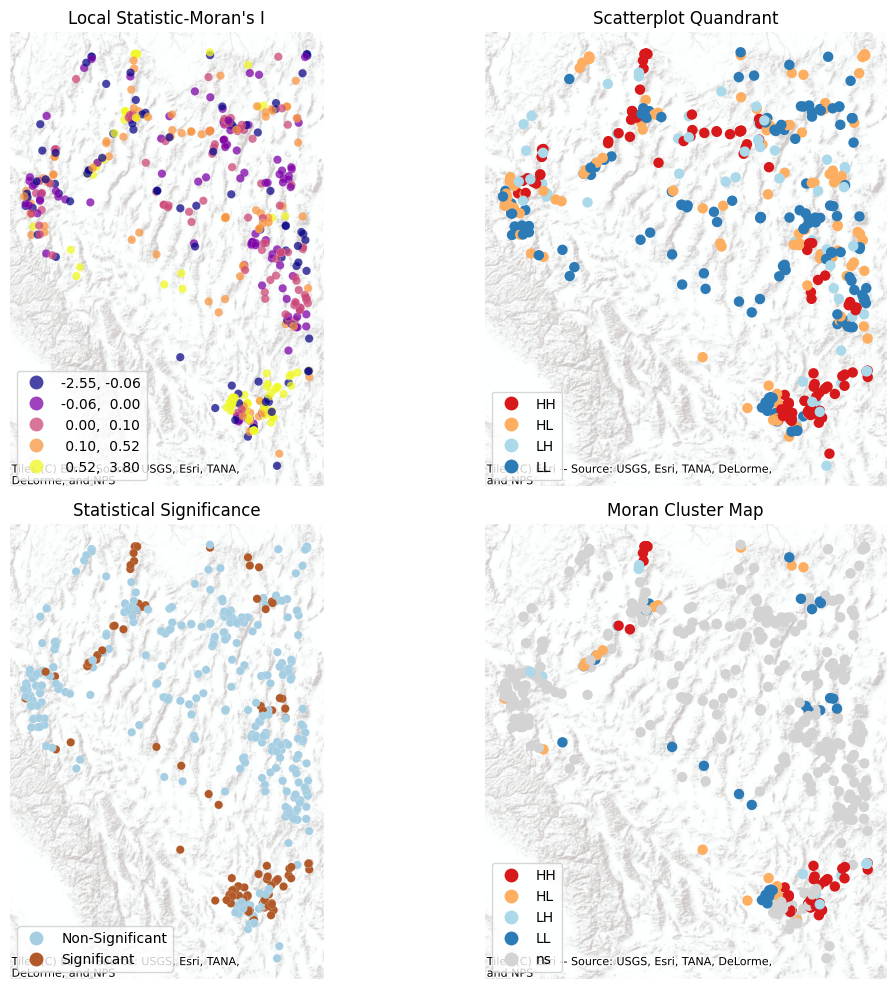

In [125]:
display_clusters(lisa_v_22,wildfire_df_22)

In [126]:
#counting no. of obs in each quandrant
#2020
count=pd.value_counts(lisa_v_20.q)
count

3    283
1    226
4    150
2     76
Name: count, dtype: int64

In [127]:
#counting no. of obs in each quandrant
#2021
count=pd.value_counts(lisa_v_21.q)
count

1    204
3    182
4    112
2     75
Name: count, dtype: int64

In [128]:
#counting no. of obs in each quandrant
#2022
count=pd.value_counts(lisa_v_22.q)
count

3    162
1    129
4    107
2     74
Name: count, dtype: int64

In [129]:
#proportion on values that are significant
print(f"significant clusters vpd 2020: {(lisa_v_20.p_sim < 0.05).sum() * 100 / len(lisa_v_20.p_sim)}")
print(f"significant clusters vpd 2021: {(lisa_v_21.p_sim < 0.05).sum() * 100 / len(lisa_v_21.p_sim)}")
print(f"significant clusters vpd 2022: {(lisa_v_22.p_sim < 0.05).sum() * 100 / len(lisa_v_22.p_sim)}")

significant clusters vpd 2020: 34.14965986394558
significant clusters vpd 2021: 27.574171029668413
significant clusters vpd 2022: 26.694915254237287


In [130]:
#assigning p values and significance to dataframes
wildfire_df_20['p_sim_vpd']=lisa_v_20.p_sim
sig_20=1*(lisa_v_20.p_sim<0.05)
wildfire_df_20['sig_vpd']=sig_20

wildfire_df_21['p_sim_vpd']=lisa_v_21.p_sim
sig_21=1*(lisa_v_21.p_sim<0.05)
wildfire_df_21['sig_vpd']=sig_21

wildfire_df_22['p_sim_vpd']=lisa_v_22.p_sim
sig_22=1*(lisa_v_22.p_sim<0.05)
wildfire_df_22['sig_vpd']=sig_22

wildfire_df_20[['p_sim_vpd','sig_vpd']].head(5)

,p_sim_vpd,sig_vpd
22938,0.048,1
22818,0.006,1
22939,0.162,0
23029,0.009,1
23042,0.034,1


In [131]:
#assign cluster labels to df
spots=lisa_v_20.q*sig_20


wildfire_df_20['cl_v']=pd.Series(data=spots,index=wildfire_df_20.index).map(spots_labels)
wildfire_df_20[['cl_v']].head(5)

,cl_v
22938,LL
22818,LH
22939,non-significant
23029,LL
23042,LH


In [132]:
#assign cluster labels to df
spots=lisa_v_21.q*sig_21


wildfire_df_21['cl_v']=pd.Series(data=spots,index=wildfire_df_21.index).map(spots_labels)
wildfire_df_21[['cl_v']].head(5)

,cl_v
23468,non-significant
23273,non-significant
23469,LL
24618,non-significant
23470,non-significant


In [133]:
#assign cluster labels to df
spots=lisa_v_22.q*sig_22

wildfire_df_22['cl_v']=pd.Series(data=spots,index=wildfire_df_22.index).map(spots_labels)
wildfire_df_20[['cl_v']].head(5)

,cl_v
22938,LL
22818,LH
22939,non-significant
23029,LL
23042,LH


In [134]:
wildfire_df_20['cl_v'].value_counts()

cl_v
non-significant    484
HH                 125
LL                  91
LH                  18
HL                  17
Name: count, dtype: int64

In [135]:
wildfire_df_21['cl_v'].value_counts()

cl_v
non-significant    415
HH                  69
LL                  51
HL                  28
LH                  10
Name: count, dtype: int64

In [136]:
wildfire_df_22['cl_v'].value_counts()

cl_v
non-significant    346
HH                  51
LL                  38
HL                  21
LH                  16
Name: count, dtype: int64

Clustering

In [137]:
#finding extent of the point pattern
new_data_20=[]
new_data_20=pd.DataFrame(new_data_20)
new_data_20['x']=wildfire_df_20.geometry.x
new_data_20['y']=wildfire_df_20.geometry.y
coordinates_20=new_data_20[['x','y']].values
convex_hull_20=centrography.ConvexHull(coordinates_20)

new_data_21=[]
new_data_21=pd.DataFrame(new_data_21)
new_data_21['x']=wildfire_df_21.geometry.x
new_data_21['y']=wildfire_df_21.geometry.y
coordinates_21=new_data_21[['x','y']].values
convex_hull_21=centrography.ConvexHull(coordinates_21)

new_data_22=[]
new_data_22=pd.DataFrame(new_data_22)
new_data_22['x']=wildfire_df_22.geometry.x
new_data_22['y']=wildfire_df_22.geometry.y
coordinates_22=new_data_22[['x','y']].values
convex_hull_22=centrography.ConvexHull(coordinates_22)

In [138]:
#computing poisson distribution
poisson_20=random.poisson(convex_hull_20,size=len(coordinates_20))
poisson_21=random.poisson(convex_hull_21,size=len(coordinates_21))
poisson_22=random.poisson(convex_hull_22,size=len(coordinates_22))

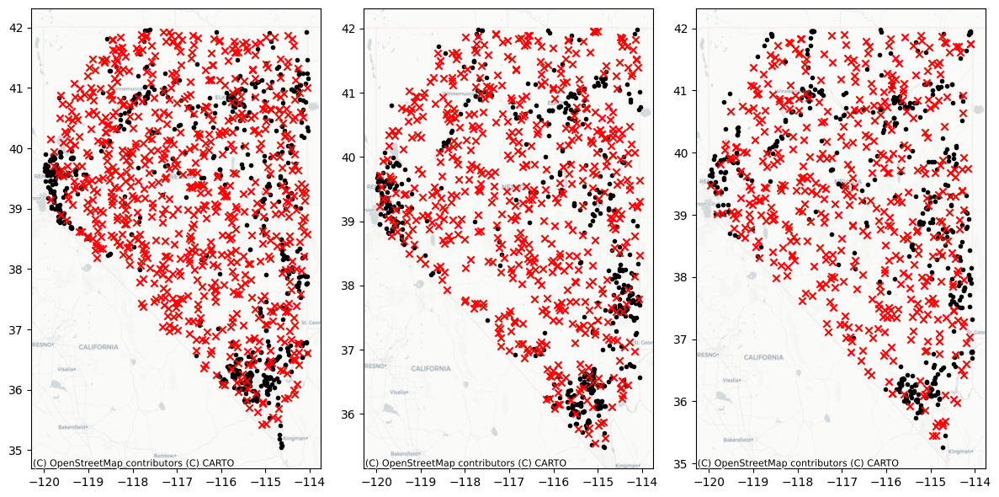

In [139]:
f, ax = plt.subplots(1,3, figsize=(12, 6))
ax[0].scatter(*coordinates_20.T,marker='.',color='k',label='observed')
ax[0].scatter(*poisson_20.T,color='r',marker='x',label='random')

cx.add_basemap(
    ax=ax[0], crs=wildfire_df_20.crs,source=cx.providers.CartoDB.Positron
)

ax[1].scatter(*coordinates_21.T, color="k", marker=".", label="Observed")
ax[1].scatter(
    *poisson_21.T, color="r", marker="x", label="Random"
)
cx.add_basemap(
    ax=ax[1], crs=wildfire_df_21.crs,source=cx.providers.CartoDB.Positron
)

ax[2].scatter(*coordinates_22.T, color="k", marker=".", label="Observed")
ax[2].scatter(
    *poisson_22.T, color="r", marker="x", label="Random"
)
cx.add_basemap(
    ax=ax[2], crs=wildfire_df_22.crs,source=cx.providers.CartoDB.Positron
)
f.tight_layout()
plt.show()

In [140]:
#ripley g 
g_test_20 = distance_statistics.g_test(
    coordinates_20, support=40, keep_simulations=True
)

In [141]:
#ripley g for poisson distribution
g_test_20_p = distance_statistics.g_test(
    poisson_20, support=40, keep_simulations=True
)

In [142]:
g_test_21 = distance_statistics.g_test(
    coordinates_21, support=40, keep_simulations=True
)

In [143]:
g_test_22 = distance_statistics.g_test(
    coordinates_22, support=40, keep_simulations=True
)

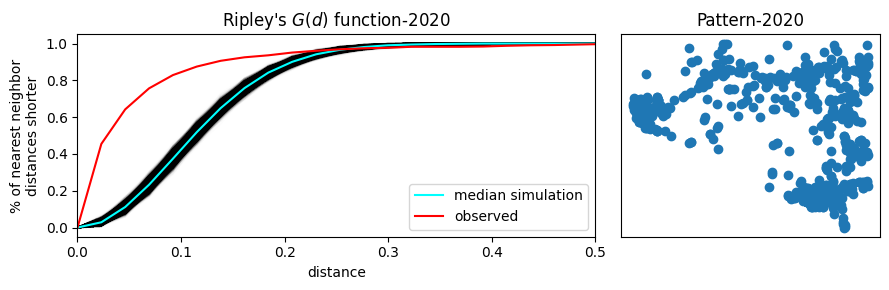

In [144]:
def plot_ripley(g_test,coordinates,year):
    f, ax = plt.subplots(
        1, 2, figsize=(9, 3), gridspec_kw=dict(width_ratios=(6, 3))
    )
    #plot all the simulations with very fine lines
    ax[0].plot(
        g_test.support, g_test.simulations.T, color="k", alpha=0.01
    )
    # and show the average of simulations
    ax[0].plot(
        g_test.support,
        np.median(g_test_20.simulations, axis=0),
        color="cyan",
        label="median simulation",
    )


    # and the observed pattern's G function
    ax[0].plot(
        g_test.support, g_test.statistic, label="observed", color="red"
    )

    # clean up labels and axes
    ax[0].set_xlabel("distance")
    ax[0].set_ylabel("% of nearest neighbor\ndistances shorter")
    ax[0].legend()
    ax[0].set_xlim(0, 0.5)
    ax[0].set_title(f"Ripley's $G(d)$ function-{year}")

    # plot the pattern itself on the next frame
    ax[1].scatter(*coordinates.T)

    # and clean up labels and axes there, too
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_xticklabels([])
    ax[1].set_yticklabels([])
    ax[1].set_title(f"Pattern-{year}")
    f.tight_layout()
    plt.show()

plot_ripley(g_test_20,coordinates_20,2020)

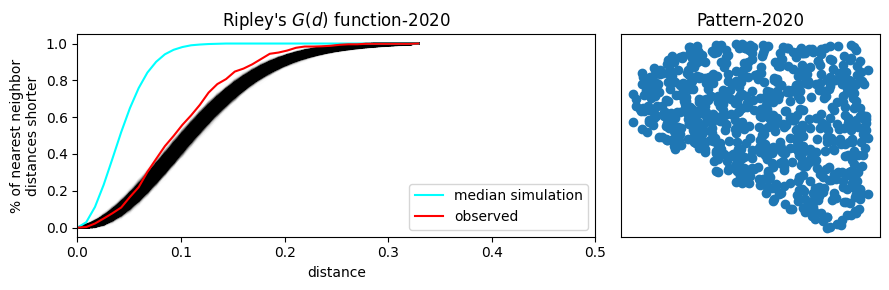

In [145]:
plot_ripley(g_test_20_p,poisson_20,2020) #plot for poisson distribution

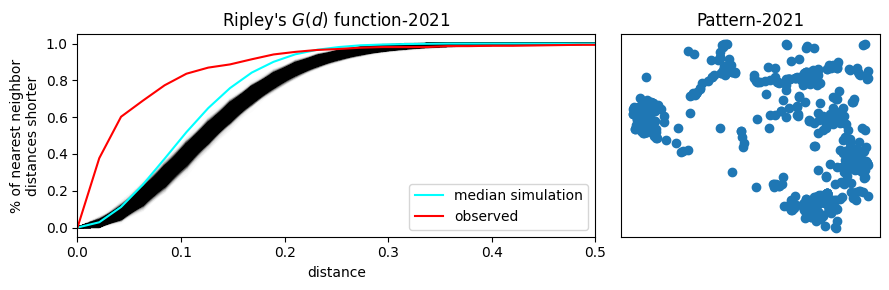

In [146]:
plot_ripley(g_test_21,coordinates_21,2021)

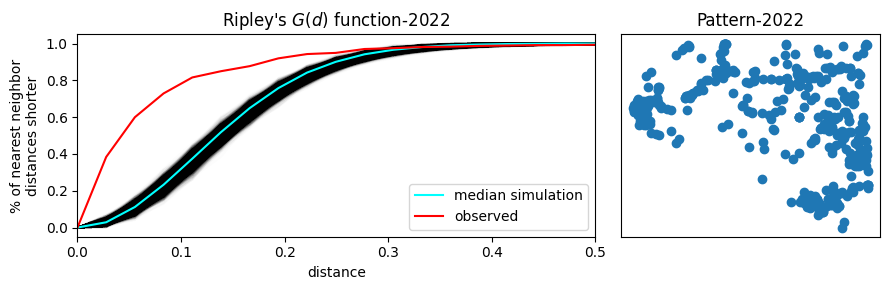

In [147]:
plot_ripley(g_test_22,coordinates_22,2022)

In [148]:
#identifying clusters using DBSCAN - 2020
clusters_20=DBSCAN()
clusters_20.fit(new_data_20[['x','y']])

DBSCAN()

In [149]:
clusters_20.core_sample_indices_[:5]

array([0, 1, 2, 3, 4])

In [150]:
#2021
clusters_21=DBSCAN()
clusters_21.fit(new_data_21[['x','y']])

DBSCAN()

In [151]:
#2022
clusters_22=DBSCAN()
clusters_22.fit(new_data_22[['x','y']])

DBSCAN()

In [152]:
#extracting labels from clusters
lbls_20 = pd.Series(clusters_20.labels_, index=new_data_20.index)
lbls_21 = pd.Series(clusters_21.labels_, index=new_data_21.index)
lbls_22 = pd.Series(clusters_22.labels_, index=new_data_22.index)

In [153]:
def plot_clusters(db,lbls,Crs=wildfire_df_20.crs):
    # Setup figure and axis
    f, ax = plt.subplots(1, figsize=(6, 6))
    # Subset points that are not part of any cluster (noise)
    noise = db.loc[lbls == -1, ["x", "y"]]
    # Plot noise in grey
    ax.scatter(noise["x"], noise["y"], c="k", s=10, linewidth=0)
    # Plot all points that are not noise in red
    # NOTE how this is done through some fancy indexing, where
    #      we take the index of all points (tw) and substract from
    #      it the index of those that are noise
    ax.scatter(
        db.loc[db.index.difference(noise.index), "x"],
        db.loc[db.index.difference(noise.index), "y"],
        c="red",
        linewidth=0,
    )
    # Add basemap
    cx.add_basemap(
        ax, crs=Crs,source=cx.providers.CartoDB.Positron
    )
    # Remove axes
    ax.set_axis_off()
    # Display the figure
    plt.show()

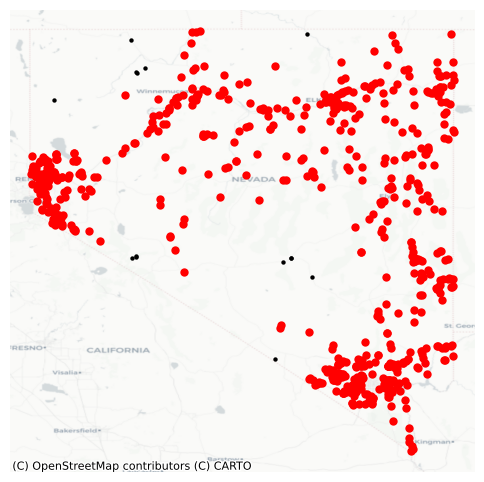

In [154]:
#2020
plot_clusters(new_data_20,lbls_20)

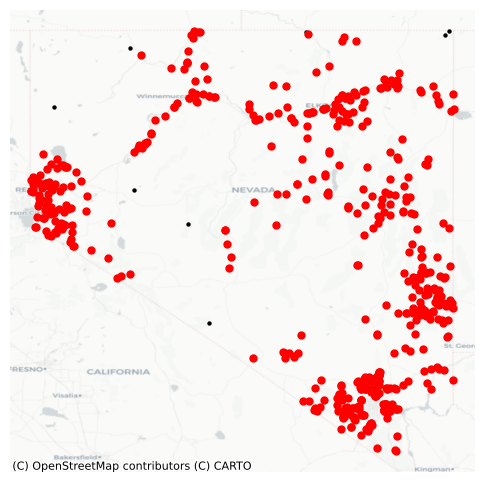

In [155]:
#2021
plot_clusters(new_data_21,lbls_21)

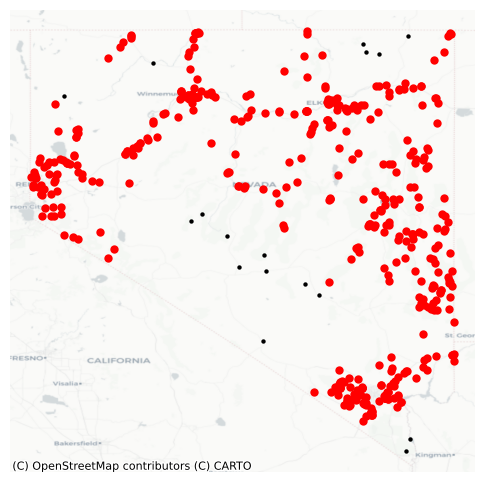

In [156]:
#2022
plot_clusters(new_data_22,lbls_22)

In [157]:
clusters_variables=[
    "mean_temp",
    'mean_prec',
    "mean_vpd",
]

In [158]:
#scaling the values
db_scaled_20=robust_scale(wildfire_df_20[clusters_variables])
db_scaled_21=robust_scale(wildfire_df_21[clusters_variables])
db_scaled_22=robust_scale(wildfire_df_22[clusters_variables])

In [159]:
#applying hierarichal clustering

model_20 = AgglomerativeClustering(
    linkage="ward", connectivity=w_20.sparse, n_clusters=5
)

model_21 = AgglomerativeClustering(
    linkage="ward", connectivity=w_21.sparse, n_clusters=5
)

model_22 = AgglomerativeClustering(
    linkage="ward", connectivity=w_22.sparse, n_clusters=5
)
# Fit algorithm to the data
model_20.fit(db_scaled_20)
model_21.fit(db_scaled_21)
model_22.fit(db_scaled_22)

AgglomerativeClustering(connectivity=<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 3776 stored elements and shape (472, 472)>,
                        n_clusters=5)

In [160]:
tempo_data_20=wildfire_df_20.copy()
tempo_data_21=wildfire_df_21.copy()
tempo_data_22=wildfire_df_22.copy()

In [161]:
tempo_data_20['cluster']=model_20.labels_
tempo_data_21['cluster']=model_21.labels_
tempo_data_22['cluster']=model_22.labels_

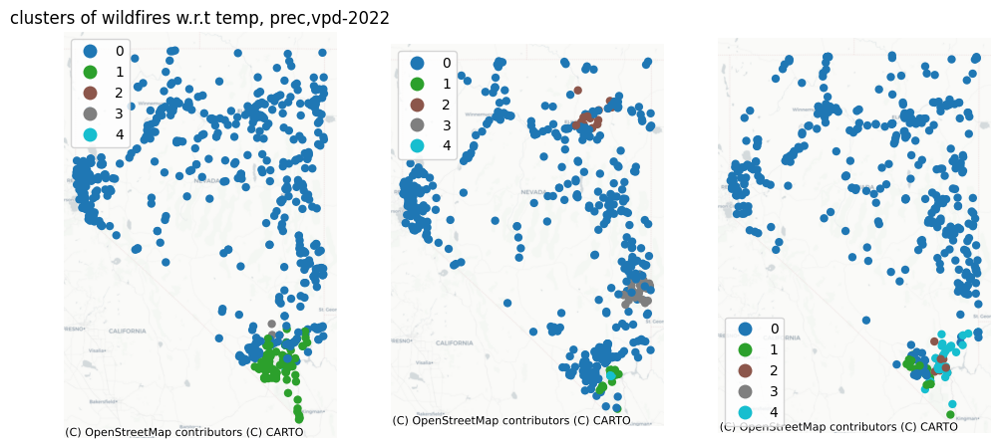

In [162]:
# Setup figure and ax
f, ax = plt.subplots(1,3, figsize=(12, 6))
# Plot unique values choropleth
# including a legend and with no boundary lines
tempo_data_20.plot(
    column="cluster",
    categorical=True,
    legend=True,
    linewidth=0,
    ax=ax[0],
)
cx.add_basemap(ax=ax[0],crs=tempo_data_20.crs,source=cx.providers.CartoDB.Positron)
ax[0].set_title("clusters of wildfires w.r.t temp, prec,vpd-2020")

tempo_data_21.plot(
    column="cluster",
    categorical=True,
    legend=True,
    linewidth=0,
    ax=ax[1],
)
cx.add_basemap(ax=ax[1],crs=tempo_data_20.crs,source=cx.providers.CartoDB.Positron)
ax[0].set_title("clusters of wildfires w.r.t temp, prec,vpd-2021")

tempo_data_22.plot(
    column="cluster",
    categorical=True,
    legend=True,
    linewidth=0,
    ax=ax[2],
)
cx.add_basemap(ax=ax[2],crs=tempo_data_20.crs,source=cx.providers.CartoDB.Positron)
ax[0].set_title("clusters of wildfires w.r.t temp, prec,vpd-2022")

# Remove axis
ax[0].set_axis_off()
ax[1].set_axis_off()
ax[2].set_axis_off()

# Display the map
plt.show()

In [163]:
#finding means according to each category to explain clustering results
cluster_means_20 = tempo_data_20.groupby('cluster')[clusters_variables].mean().reset_index()
cluster_means_21 = tempo_data_21.groupby('cluster')[clusters_variables].mean().reset_index()
cluster_means_22 = tempo_data_22.groupby('cluster')[clusters_variables].mean().reset_index()

# Display the result
print(cluster_means_20)
print(f"\n{cluster_means_21}")
print(f"\n{cluster_means_22}")

   cluster  mean_temp   mean_prec   mean_vpd
0        0  19.457658    5.539553  35.975310
1        1  26.115607    0.623671  52.161052
2        2   4.000000  165.906006   6.151000
3        3   4.666667   65.367332   9.994667
4        4  12.333333   48.444332  16.382999

   cluster  mean_temp  mean_prec   mean_vpd
0        0  20.405405  13.812681  35.469116
1        1  29.866667  13.892560  56.894405
2        2   8.058824  38.950158  14.711676
3        3  26.333333  64.773038  42.174357
4        4  11.555556   2.692944  20.427100

   cluster  mean_temp   mean_prec   mean_vpd
0        0  20.432225   16.108234  36.069279
1        1  13.259259    6.851904  22.760889
2        2  13.666667    2.806327  24.746286
3        3  15.500000  142.920769  15.841850
4        4  31.571429   14.894471  61.654210


Spatial Regression

In [164]:
wild_fire_all.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1780 entries, 0 to 1779
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   Fire_Name      1780 non-null   object  
 1   Acres          1780 non-null   float64 
 2   District       1780 non-null   object  
 3   Day            1780 non-null   int32   
 4   Month          1780 non-null   int32   
 5   Year           1780 non-null   int32   
 6   geometry       1780 non-null   geometry
 7   State          1780 non-null   object  
 8   County         1780 non-null   object  
 9   mean_temp      1780 non-null   int64   
 10  mean_prec      1780 non-null   float64 
 11  mean_vpd       1780 non-null   float64 
 12  mean_temp_lag  1780 non-null   float64 
 13  mean_prec_lag  1780 non-null   float64 
 14  mean_vpd_lag   1780 non-null   float64 
 15  season         1780 non-null   object  
dtypes: float64(6), geometry(1), int32(3), int64(1), object(5)
memory usage

In [165]:
#features for regression
variable_names=[
    "mean_prec",
    "mean_temp",
    'mean_vpd'
]

In [166]:
#fitting a simple linear regression model
model_20_l=spreg.OLS(wildfire_df_20[['Acres']].values,wildfire_df_20[variable_names].values,name_y='Acres',name_x=variable_names)

In [167]:
#finding residuals autocorrelation
moran_20_l=esda.moran.Moran(model_20_l.u.flatten(),w_20)
print(moran_20_l.I)
print(moran_20_l.p_sim)

0.10463417433057934
0.003


(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.1', ylabel='Density'>,
        <Axes: title={'center': 'Moran Scatterplot (0.1)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

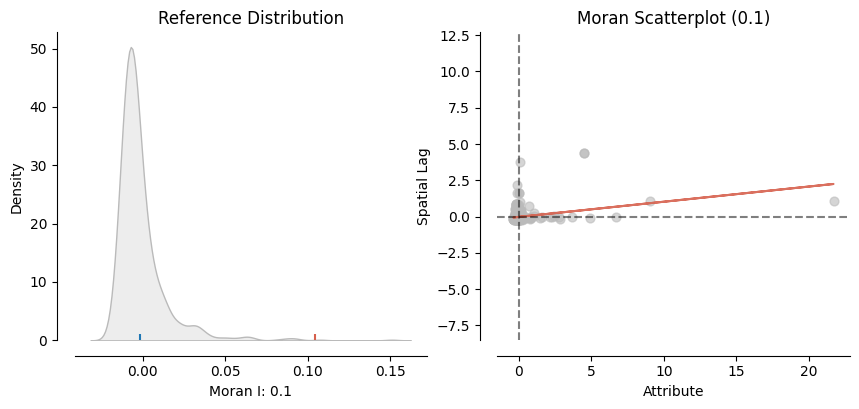

In [168]:
plot_moran(moran_20_l)

In [169]:
# spreg spatial fixed effect implementation
model_20_f = spreg.OLS_Regimes(
    # Dependent variable
    wildfire_df_20[["Acres"]].values,
    # Independent variables
    wildfire_df_20[variable_names].values,
    # Variable specifying neighborhood membership
    wildfire_df_20["County"].tolist(),
    # Allow the constant term to vary by group/regime
    constant_regi="many",
    # Variables to be allowed to vary (True) or kept
    # constant (False). Here we set all to False
    cols2regi=[False] * len(variable_names),
    # Allow separate sigma coefficients to be estimated
    # by regime (False so a single sigma)
    regime_err_sep=False,
    # Dependent variable name
    name_y="Acres",
    # Independent variables names
    name_x=variable_names,
)

In [170]:
#finding residuals autocorrelation
moran_20_f=esda.moran.Moran(model_20_f.u.flatten(),w_20)
print(moran_20_f.I)
print(moran_20_f.p_sim)

0.0790211837604227
0.002


(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.08', ylabel='Density'>,
        <Axes: title={'center': 'Moran Scatterplot (0.08)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

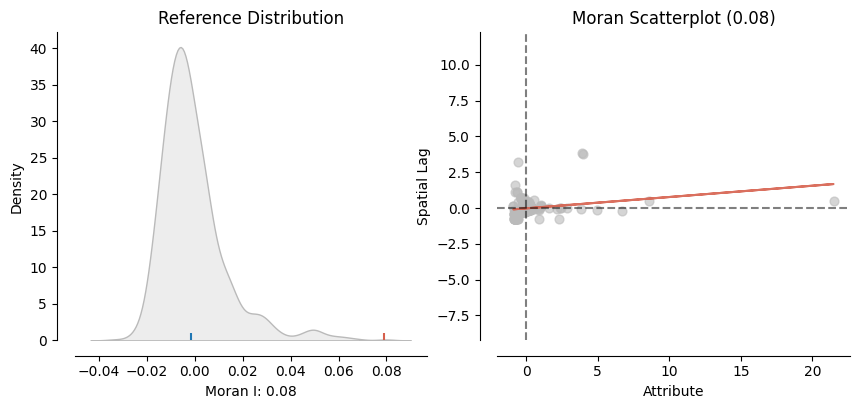

In [171]:
plot_moran(moran_20_f)

In [172]:
# spreg spatial fixed effect implementation 2021
model_21_f = spreg.OLS_Regimes(
    # Dependent variable
    wildfire_df_21[["Acres"]].values,
    # Independent variables
    wildfire_df_21[variable_names].values,
    # Variable specifying neighborhood membership
    wildfire_df_21["County"].tolist(),
    # Allow the constant term to vary by group/regime
    constant_regi="many",
    # Variables to be allowed to vary (True) or kept
    # constant (False). Here we set all to False
    cols2regi=[False] * len(variable_names),
    # Allow separate sigma coefficients to be estimated
    # by regime (False so a single sigma)
    regime_err_sep=False,
    # Dependent variable name
    name_y="Acres",
    # Independent variables names
    name_x=variable_names,
)

In [173]:
#finding residuals autocorrelation
moran_21_f=esda.moran.Moran(model_21_f.u.flatten(),w_21)
print(moran_21_f.I)
print(moran_21_f.p_sim)

0.038890424569116046
0.016


(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.04', ylabel='Density'>,
        <Axes: title={'center': 'Moran Scatterplot (0.04)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

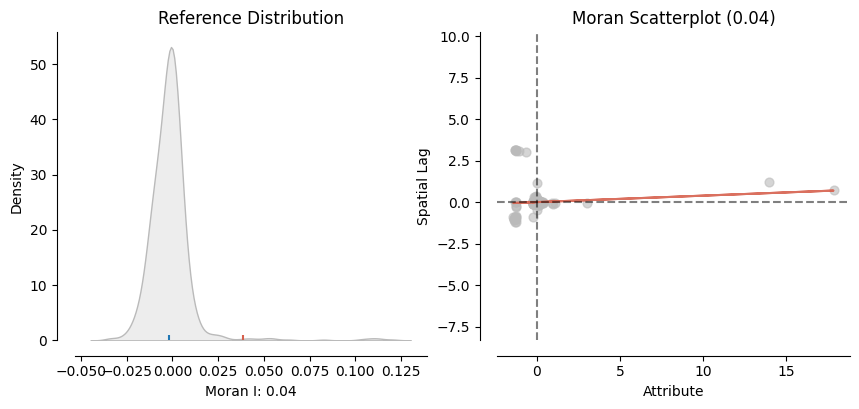

In [174]:
plot_moran(moran_21_f)

In [175]:
# Fit spatial lag model with `spreg` 2021
# (GMM estimation)
model_21_s = spreg.GM_Lag(
    # Dependent variable
    wildfire_df_21[["Acres"]].values,
    # Independent variables
    wildfire_df_21[variable_names].values,
    # Spatial weights matrix
    w=w_21,
    # Dependent variable name
    name_y="Acres",
    # Independent variables names
    name_x=variable_names,
)

In [176]:
#finding residuals autocorrelation
moran_21_s=esda.moran.Moran(model_21_s.u.flatten(),w_21)
print(moran_21_s.I)
print(moran_21_s.p_sim)

0.2422800741490423
0.001


(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.24', ylabel='Density'>,
        <Axes: title={'center': 'Moran Scatterplot (0.24)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

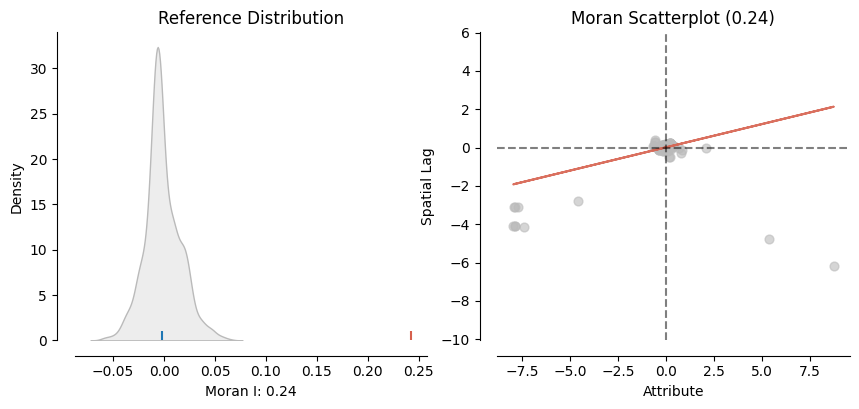

In [177]:
plot_moran(moran_21_s)

In [178]:
# Fit spatial lag model with `spreg` 2022
# (GMM estimation)
model_22_s = spreg.GM_Lag(
    # Dependent variable
    wildfire_df_22[["Acres"]].values,
    # Independent variables
    wildfire_df_22[variable_names].values,
    # Spatial weights matrix
    w=w_22,
    # Dependent variable name
    name_y="Acres",
    # Independent variables names
    name_x=variable_names,
)

In [179]:
#finding residuals autocorrelation
moran_22_s=esda.moran.Moran(model_22_s.u.flatten(),w_22)
print(moran_22_s.I)
print(moran_22_s.p_sim)

-0.004379998625564879
0.44


(<Figure size 1000x400 with 2 Axes>,
 array([<Axes: title={'center': 'Reference Distribution'}, xlabel='Moran I: -0.0', ylabel='Density'>,
        <Axes: title={'center': 'Moran Scatterplot (-0.0)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

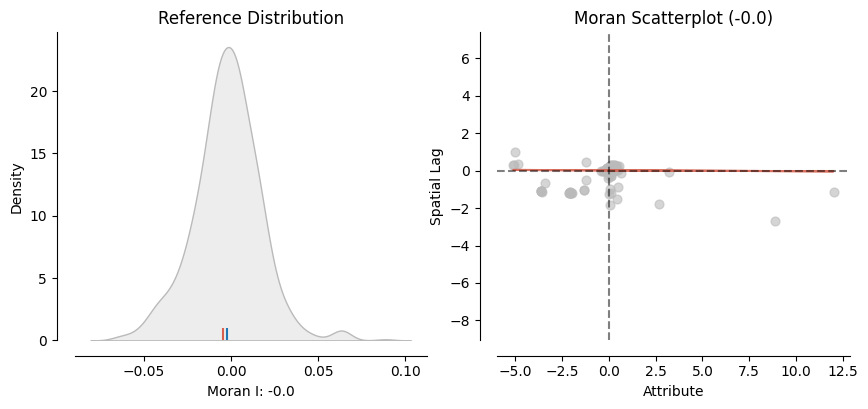

In [180]:
plot_moran(moran_22_s)